# Perperation

Import dataset from git and setup test set.

In [1]:
!git clone https://github.com/Rasilu/cil
!cp -r cil/datasets/kaggle_data/test/ ./

Cloning into 'cil'...
remote: Enumerating objects: 21035, done.
remote: Counting objects: 100% (4844/4844), done.
remote: Compressing objects: 100% (4843/4843), done.
remote: Total 21035 (delta 0), reused 4842 (delta 0), pack-reused 16191
Receiving objects: 100% (21035/21035), 2.87 GiB | 26.33 MiB/s, done.
Resolving deltas: 100% (1026/1026), done.
Checking out files: 100% (18427/18427), done.


# U-Net

The introduction of U-Net can be found in material of Tutorial 9. U-Net has been widely deployed in the field of Computer Vision. Here, instead of considering the problem patch-wise, we predict **pixel-wise label** for each image. Our model will receive a large image covering multiple patches and output a single channel greyscale image at the same resolution. We will then use our brightness-based heuristic to transform the output into labels.

Note: our implementation differs from the original by introducing Batch Normalization layers and padded convolutions to avoid cropping features.



![]( 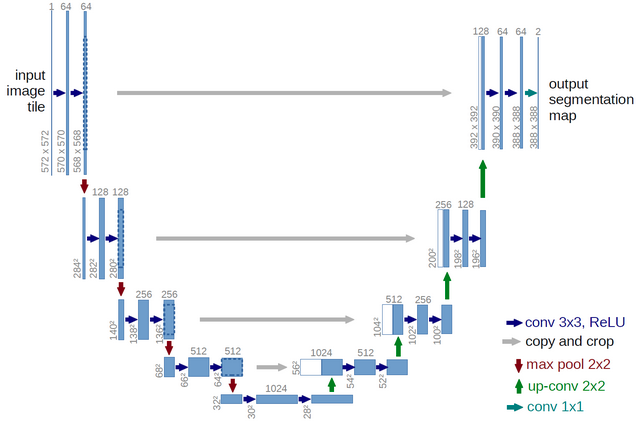)

In [2]:
# some basic imports

import time
import math
import os
import re
import cv2
import numpy as np
import matplotlib.pyplot as plt
from glob import glob
from random import sample
from PIL import Image

Some additional methods:

In [4]:
# some constants
PATCH_SIZE = 16  # pixels per side of square patches
VAL_SIZE = 10  # size of the validation set (number of images)
CUTOFF = 0.25  # minimum average brightness for a mask patch to be classified as containing road

test_path='test/images'

In [28]:

def calculatePatches(path):
    images = load_all_from_path(path + '/images')[:,:,:,:3]
    masks = load_all_from_path(path + '/groundtruth')

    patches, labels = image_to_patches(images, masks)

    print("{0:0.2f}".format(sum(labels) / len(labels) * 100) + '% of training patches are labeled as 1.')
    
def load_all_from_path(path):
    # loads all HxW .pngs contained in path as a 4D np.array of shape (n_images, H, W, 3)
    # images are loaded as floats with values in the interval [0., 1.]
    return np.stack([np.array(Image.open(f)) for f in sorted(glob(path + '/*.png'))]).astype(np.float32) / 255.

def image_to_patches(images, masks=None):
    # takes in a 4D np.array containing images and (optionally) a 4D np.array containing the segmentation masks
    # returns a 4D np.array with an ordered sequence of patches extracted from the image and (optionally) a np.array containing labels
    n_images = images.shape[0]  # number of images
    h, w = images.shape[1:3]  # shape of images
    assert (h % PATCH_SIZE) + (w % PATCH_SIZE) == 0  # make sure images can be patched exactly

    images = images[:,:,:,:3]
    
    h_patches = h // PATCH_SIZE
    w_patches = w // PATCH_SIZE
    
    patches = images.reshape((n_images, h_patches, PATCH_SIZE, w_patches, PATCH_SIZE, -1))
    patches = np.moveaxis(patches, 2, 3)
    patches = patches.reshape(-1, PATCH_SIZE, PATCH_SIZE, 3)
    if masks is None:
        return patches

    masks = masks.reshape((n_images, h_patches, PATCH_SIZE, w_patches, PATCH_SIZE, -1))
    masks = np.moveaxis(masks, 2, 3)
    labels = np.mean(masks, (-1, -2, -3)) > CUTOFF  # compute labels
    labels = labels.reshape(-1).astype(np.float32)
    return patches, labels
    
def accuracy_fn(y_hat, y):
    # computes classification accuracy
    return (y_hat.round() == y.round()).float().mean()

def patch_accuracy_fn(y_hat, y):
    # computes accuracy weighted by patches (metric used on Kaggle for evaluation)
    h_patches = y.shape[-2] // PATCH_SIZE
    w_patches = y.shape[-1] // PATCH_SIZE
    patches_hat = y_hat.reshape(-1, 1, h_patches, PATCH_SIZE, w_patches, PATCH_SIZE).mean((-1, -3)) > CUTOFF
    patches = y.reshape(-1, 1, h_patches, PATCH_SIZE, w_patches, PATCH_SIZE).mean((-1, -3)) > CUTOFF
    return (patches == patches_hat).float().mean()

def show_val_samples(x, y, y_hat, segmentation=False):
    # training callback to show predictions on validation set
    imgs_to_draw = min(5, len(x))
    if x.shape[-2:] == y.shape[-2:]:  # segmentation
        fig, axs = plt.subplots(3, imgs_to_draw, figsize=(18.5, 12))
        for i in range(imgs_to_draw):
            axs[0, i].imshow(np.moveaxis(x[i], 0, -1))
            axs[1, i].imshow(np.concatenate([np.moveaxis(y_hat[i], 0, -1)] * 3, -1))
            axs[2, i].imshow(np.concatenate([np.moveaxis(y[i], 0, -1)]*3, -1))
            axs[0, i].set_title(f'Sample {i}')
            axs[1, i].set_title(f'Predicted {i}')
            axs[2, i].set_title(f'True {i}')
            axs[0, i].set_axis_off()
            axs[1, i].set_axis_off()
            axs[2, i].set_axis_off()
    else:  # classification
        fig, axs = plt.subplots(1, imgs_to_draw, figsize=(18.5, 6))
        for i in range(imgs_to_draw):
            axs[i].imshow(np.moveaxis(x[i], 0, -1))
            axs[i].set_title(f'True: {np.round(y[i]).item()}; Predicted: {np.round(y_hat[i]).item()}')
            axs[i].set_axis_off()
    plt.show()

def train(train_dataloader, eval_dataloader, model, loss_fn, metric_fns, optimizer, n_epochs):
    # training loop
    logdir = './tensorboard/net'
    writer = SummaryWriter(logdir)  # tensorboard writer (can also log images)

    history = {}  # collects metrics at the end of each epoch

    for epoch in range(n_epochs):  # loop over the dataset multiple times

        # initialize metric list
        metrics = {'loss': [], 'val_loss': []}
        for k, _ in metric_fns.items():
            metrics[k] = []
            metrics['val_'+k] = []

        pbar = tqdm(train_dataloader, desc=f'Epoch {epoch+1}/{n_epochs}')
        # training
        model.train()
        for (x, y) in pbar:
            optimizer.zero_grad()  # zero out gradients
            y_hat = model(x)  # forward pass
            loss = loss_fn(y_hat, y)
            loss.backward()  # backward pass
            optimizer.step()  # optimize weights

            # log partial metrics
            metrics['loss'].append(loss.item())
            for k, fn in metric_fns.items():
                metrics[k].append(fn(y_hat, y).item())
            pbar.set_postfix({k: sum(v)/len(v) for k, v in metrics.items() if len(v) > 0})

        # validation
        model.eval()
        with torch.no_grad():  # do not keep track of gradients
            for (x, y) in eval_dataloader:
                y_hat = model(x)  # forward pass
                loss = loss_fn(y_hat, y)
                
                # log partial metrics
                metrics['val_loss'].append(loss.item())
                for k, fn in metric_fns.items():
                    metrics['val_'+k].append(fn(y_hat, y).item())

        # summarize metrics, log to tensorboard and display
        history[epoch] = {k: sum(v) / len(v) for k, v in metrics.items()}
        for k, v in history[epoch].items():
          writer.add_scalar(k, v, epoch)
        print(' '.join(['\t- '+str(k)+' = '+str(v)+'\n ' for (k, v) in history[epoch].items()]))
        show_val_samples(x.detach().cpu().numpy(), y.detach().cpu().numpy(), y_hat.detach().cpu().numpy())

    print('Finished Training')
    # plot loss curves
    plt.plot([v['loss'] for k, v in history.items()], label='Training Loss')
    plt.plot([v['val_loss'] for k, v in history.items()], label='Validation Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epochs')
    plt.legend()
    plt.show()

    
def create_submission(test_pred, test_filenames, submission_filename):
    with open(submission_filename, 'w') as f:
        f.write('id,prediction\n')
        for fn, patch_array in zip(sorted(test_filenames), test_pred):
            img_number = int(re.search(r"\d+", fn).group(0))
            for i in range(patch_array.shape[0]):
                for j in range(patch_array.shape[1]):
                    f.write("{:03d}_{}_{},{}\n".format(img_number, j*PATCH_SIZE, i*PATCH_SIZE, int(patch_array[i, j])))

def iou_coef(y_hat, y, smooth=1):
    intersection = (y_hat * y).sum()
    union = y_hat.sum() + y.sum() - intersection
    iou = ((intersection + smooth) / (union + smooth)).mean()

    return iou

def dice_coef(y_hat, y, smooth=1):
    intersection = (y_hat * y).sum()
    return (2. * intersection + smooth) / (y_hat.sum() + y.sum() + smooth)

def soft_dice_loss(y_hat, y):
    return 1-dice_coef(y_hat, y)

The network:

In [151]:
import torch
from torch import nn
from torch.utils.tensorboard import SummaryWriter
from tqdm.notebook import tqdm 
from torchvision import transforms

def np_to_tensor(x, device):
    # allocates tensors from np.arrays
    if device == 'cpu':
        return torch.from_numpy(x).cpu()
    else:
        return torch.from_numpy(x).contiguous().pin_memory().to(device=device, non_blocking=True)


class ImageDataset(torch.utils.data.Dataset):
    # dataset class that deals with loading the data and making it available by index.

    def __init__(self, path, device, use_patches=True, resize_to=(400, 400), preprocess_contrast=False, preprocess_gaussian=False):
        self.path = path
        self.device = device
        self.use_patches = use_patches
        self.resize_to=resize_to
        self.x, self.y, self.n_samples = None, None, None
        self._load_data()
        self.preprocess_contrast = preprocess_contrast
        self.preprocess_gaussian = preprocess_gaussian
        self.deviation = np.std(self.x)

    def _load_data(self):  # not very scalable, but good enough for now
        self.x = load_all_from_path(os.path.join(self.path, 'images'))[:,:,:,:3]
        self.y = load_all_from_path(os.path.join(self.path, 'groundtruth'))
        if self.use_patches:  # split each image into patches
            self.x, self.y = image_to_patches(self.x, self.y)
        elif self.resize_to != (self.x.shape[1], self.x.shape[2]):  # resize images
            self.x = np.stack([cv2.resize(img, dsize=self.resize_to) for img in self.x], 0)
            self.y = np.stack([cv2.resize(mask, dsize=self.resize_to) for mask in self.y], 0)
        self.x = np.moveaxis(self.x, -1, 1)  # pytorch works with CHW format instead of HWC
        self.n_samples = len(self.x)

    def _preprocess(self, x, y):
        # to keep things simple we will not apply transformations to each sample,
        # but it would be a very good idea to look into preprocessing
        if self.preprocess_contrast:
          x = (x - torch.mean(x)) / self.deviation
        if self.preprocess_gaussian:
          transform = transforms.Compose([transforms.GaussianBlur(kernel_size=51)])
          x = transform(x)
        y = (y > 0.25).float()
        return x, y

    def __getitem__(self, item):
        return self._preprocess(np_to_tensor(self.x[item], self.device), np_to_tensor(self.y[[item]], self.device))
    
    def __len__(self):
        return self.n_samples

class Block(nn.Module):
    # a repeating structure composed of two convolutional layers with batch normalization and ReLU activations
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.block = nn.Sequential(nn.Conv2d(in_channels=in_ch, out_channels=out_ch, kernel_size=3, padding=1),
                                   nn.ReLU(),
                                   nn.BatchNorm2d(out_ch),
                                   nn.Conv2d(in_channels=out_ch, out_channels=out_ch, kernel_size=3, padding=1),
                                   nn.ReLU())

    def forward(self, x):
        return self.block(x)

        
class UNet(nn.Module):
    # UNet-like architecture for single class semantic segmentation.
    def __init__(self, chs=(3,64,128,256,512,1024)):
        super().__init__()
        enc_chs = chs  # number of channels in the encoder
        dec_chs = chs[::-1][:-1]  # number of channels in the decoder
        self.enc_blocks = nn.ModuleList([Block(in_ch, out_ch) for in_ch, out_ch in zip(enc_chs[:-1], enc_chs[1:])])  # encoder blocks
        self.pool = nn.MaxPool2d(2)  # pooling layer (can be reused as it will not be trained)
        self.upconvs = nn.ModuleList([nn.ConvTranspose2d(in_ch, out_ch, 2, 2) for in_ch, out_ch in zip(dec_chs[:-1], dec_chs[1:])])  # deconvolution
        self.dec_blocks = nn.ModuleList([Block(in_ch, out_ch) for in_ch, out_ch in zip(dec_chs[:-1], dec_chs[1:])])  # decoder blocks
        self.head = nn.Sequential(nn.Conv2d(dec_chs[-1], 1, 1), nn.Sigmoid()) # 1x1 convolution for producing the output

    def forward(self, x):
        # encode
        enc_features = []
        for block in self.enc_blocks[:-1]:
            x = block(x)  # pass through the block
            enc_features.append(x)  # save features for skip connections
            x = self.pool(x)  # decrease resolution
        x = self.enc_blocks[-1](x)
        # decode
        for block, upconv, feature in zip(self.dec_blocks, self.upconvs, enc_features[::-1]):
            x = upconv(x)  # increase resolution
            x = torch.cat([x, feature], dim=1)  # concatenate skip features
            x = block(x)  # pass through the block
        return self.head(x)  # reduce to 1 channel
      

# Check performance on baseline dataset

First we set up the network and check the result on the dataset given by kaggle.

Load data from github:

In [7]:
!rm -r training_baseline/
!rm -r validation_baseline/
!cp -r cil/datasets/kaggle_data/training/ ./training_baseline


rm: cannot remove 'training_baseline/': No such file or directory
rm: cannot remove 'validation_baseline/': No such file or directory


In [8]:

# paths to training and validation datasets
train_path = 'training_baseline'
val_path = 'validation_baseline'

VAL_SIZE = 10

!mkdir validation_baseline
!mkdir validation_baseline/images
!mkdir validation_baseline/groundtruth
for img in sample(glob("training_baseline/images/*.png"), VAL_SIZE):
  os.rename(img, img.replace('training', 'validation'))
  mask = img.replace('images', 'groundtruth')
  os.rename(mask, mask.replace('training', 'validation'))

Train the network:

Epoch 1/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.5607209889327779
  	- val_loss = 0.7036195993423462
  	- acc = 0.6598671359174392
  	- val_acc = 0.29357288777828217
  	- patch_acc = 0.5975158354815315
  	- val_patch_acc = 0.2899305621782939
 


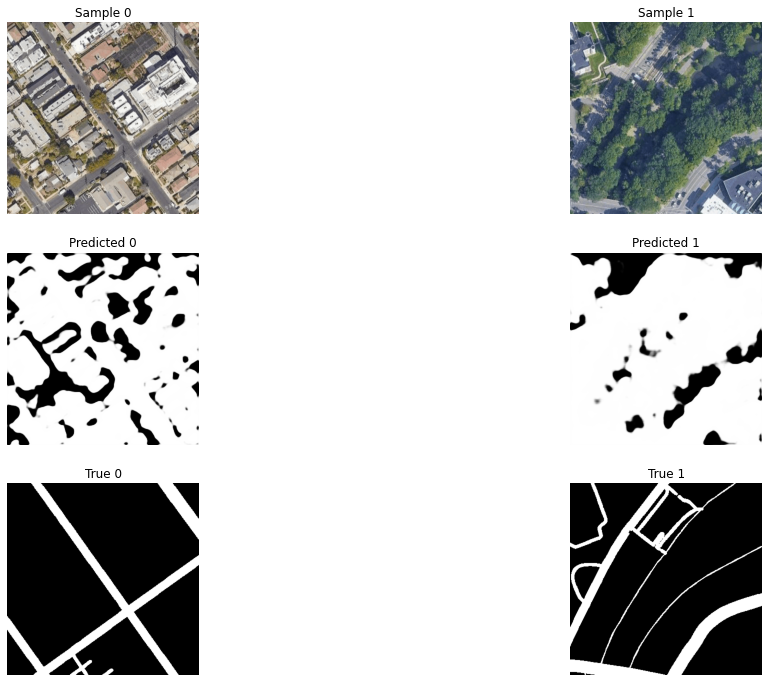

Epoch 2/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.4715342048336478
  	- val_loss = 0.6577392419179281
  	- acc = 0.7859700094251072
  	- val_acc = 0.7718466321627299
  	- patch_acc = 0.7607230438905603
  	- val_patch_acc = 0.7364004651705424
 


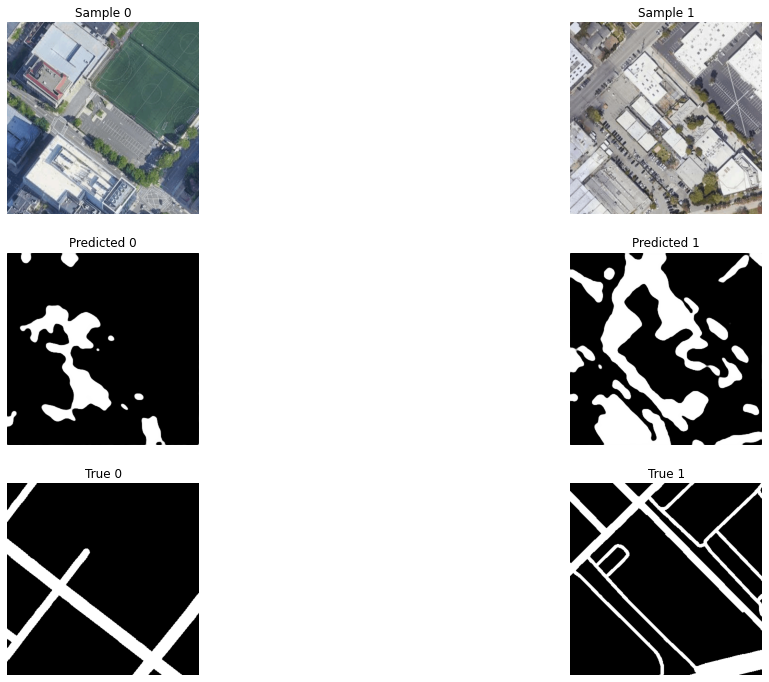

Epoch 3/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.46906941427904014
  	- val_loss = 0.5176957845687866
  	- acc = 0.7970637468730702
  	- val_acc = 0.7838298678398132
  	- patch_acc = 0.7682674702476052
  	- val_patch_acc = 0.7527488470077515
 


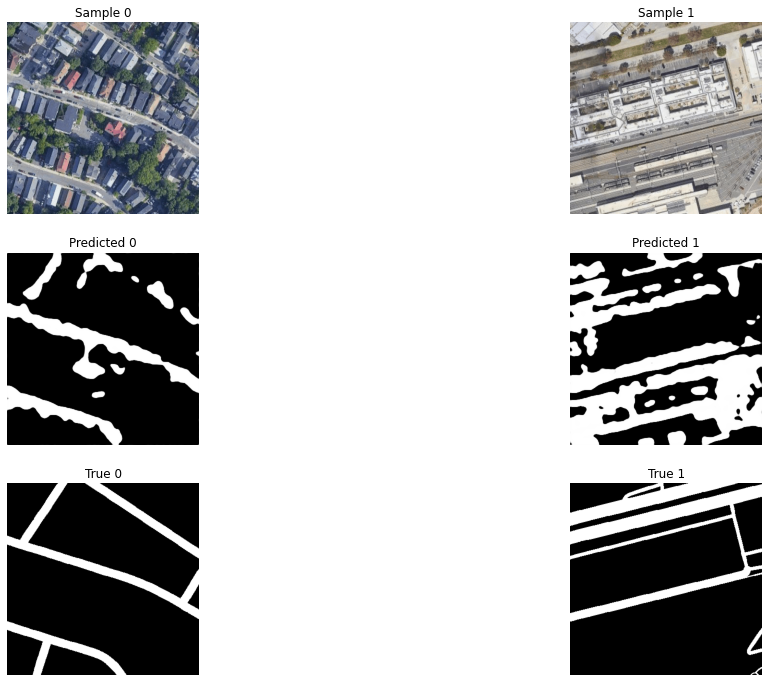

Epoch 4/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.44958439118721905
  	- val_loss = 0.5818961064020792
  	- acc = 0.8059026704115027
  	- val_acc = 0.8488611380259196
  	- patch_acc = 0.7795266596709981
  	- val_patch_acc = 0.8126446803410848
 


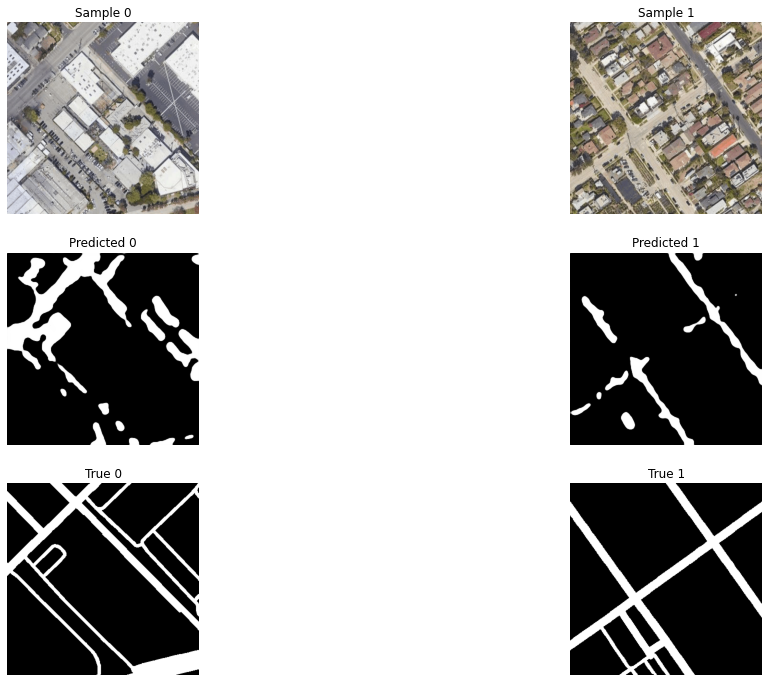

Epoch 5/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.43148750943296094
  	- val_loss = 0.4842991232872009
  	- acc = 0.8182811929899103
  	- val_acc = 0.8051718274752299
  	- patch_acc = 0.7944240254514358
  	- val_patch_acc = 0.7738715211550394
 


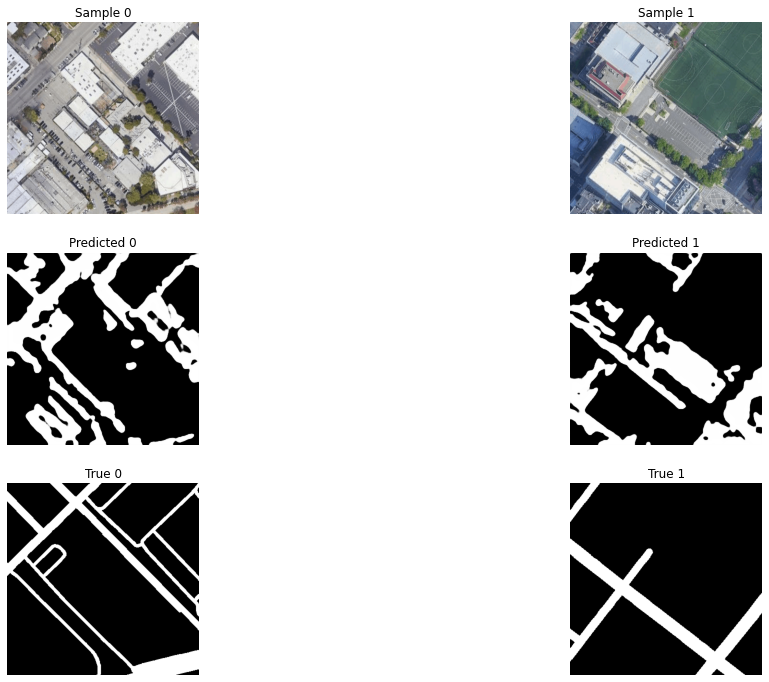

Epoch 6/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.42680887264363904
  	- val_loss = 0.6214093168576559
  	- acc = 0.8172547168591443
  	- val_acc = 0.8222136298815409
  	- patch_acc = 0.7928666332188774
  	- val_patch_acc = 0.7809606591860453
 


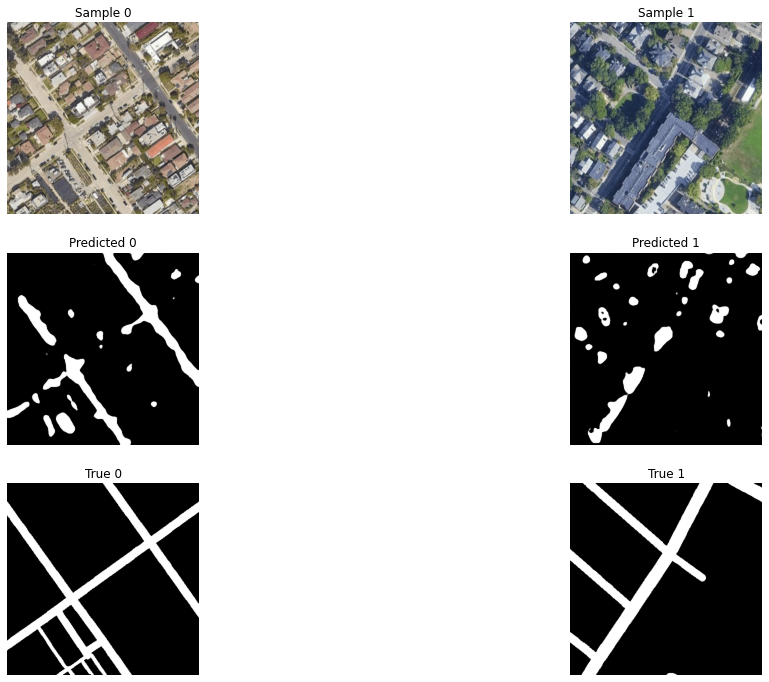

Epoch 7/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.42179740877712474
  	- val_loss = 0.49209900697072345
  	- acc = 0.8222226518041947
  	- val_acc = 0.8050531546274821
  	- patch_acc = 0.7984323974917916
  	- val_patch_acc = 0.7818287213643392
 


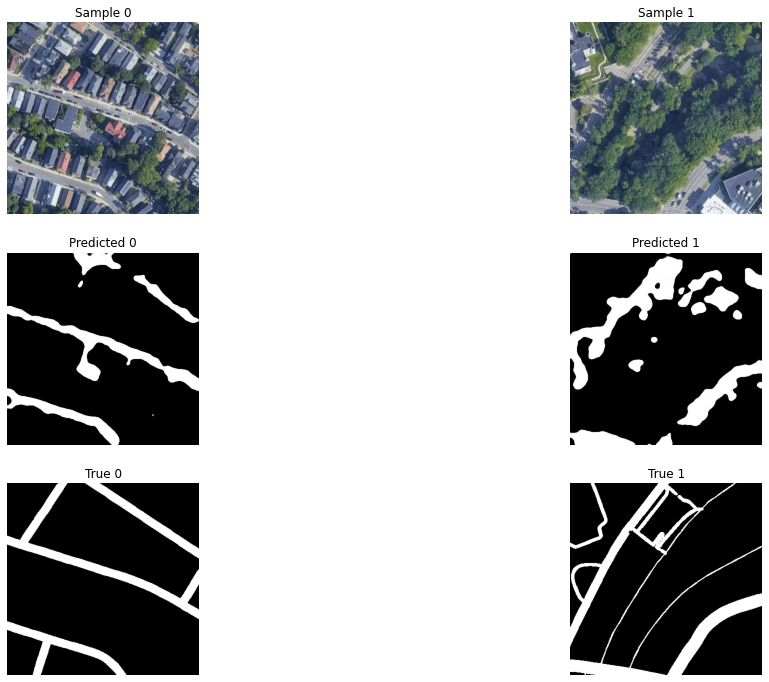

Epoch 8/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.396430187365588
  	- val_loss = 0.4743543267250061
  	- acc = 0.8395780728143805
  	- val_acc = 0.8205854694048563
  	- patch_acc = 0.8194189229432274
  	- val_patch_acc = 0.7931134303410848
 


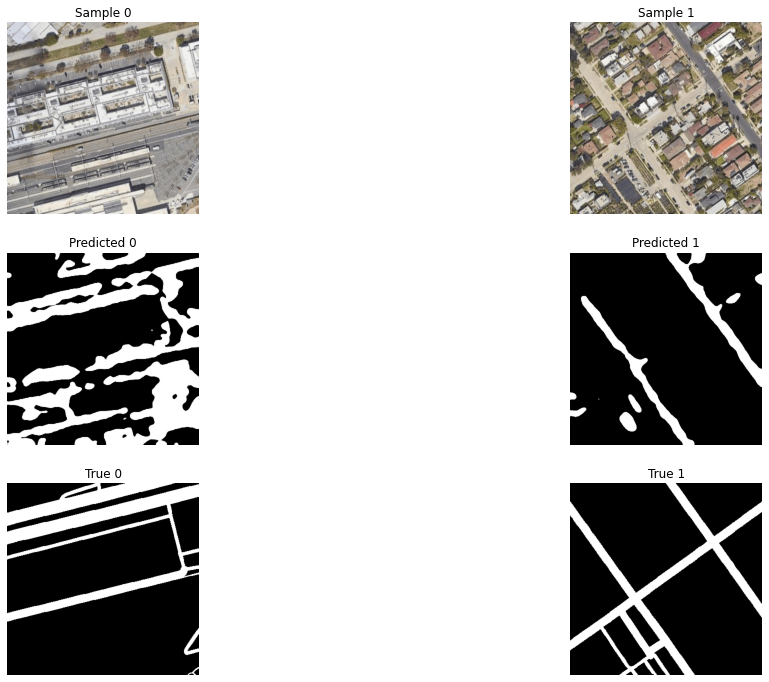

Epoch 9/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.3987595789572772
  	- val_loss = 0.4670543670654297
  	- acc = 0.8368288944749271
  	- val_acc = 0.7871602376302084
  	- patch_acc = 0.8131127532790688
  	- val_patch_acc = 0.7730034788449606
 


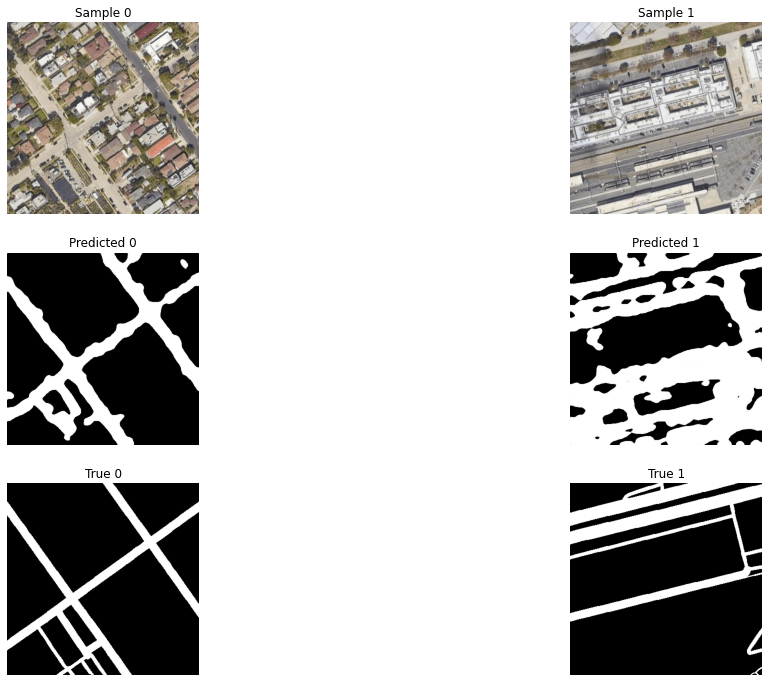

Epoch 10/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.37744682150728565
  	- val_loss = 0.4973236521085103
  	- acc = 0.8454261790303623
  	- val_acc = 0.8483118216196696
  	- patch_acc = 0.8239379157038296
  	- val_patch_acc = 0.8161169091860453
 


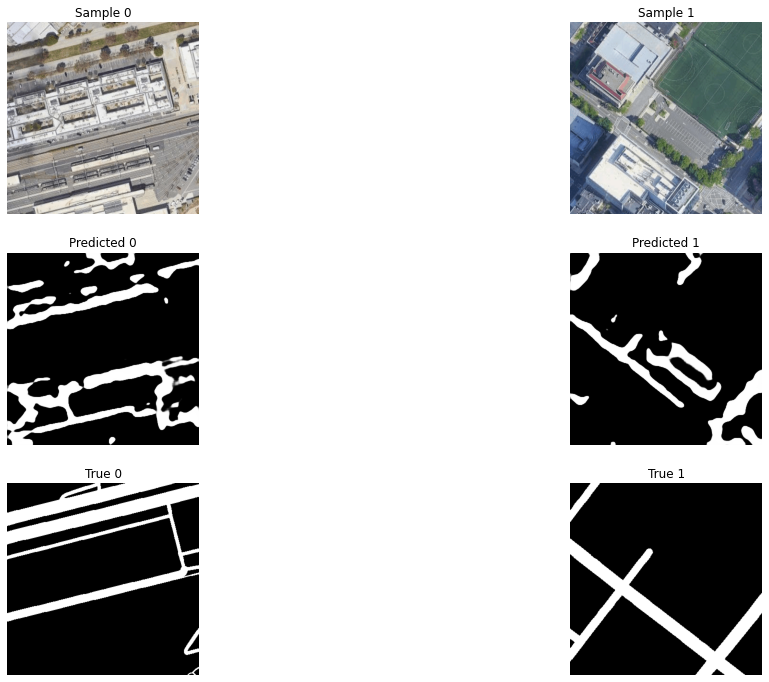

Epoch 11/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.37564684012356925
  	- val_loss = 0.4796086351076762
  	- acc = 0.8504983344498802
  	- val_acc = 0.8360895315806071
  	- patch_acc = 0.8304610988673042
  	- val_patch_acc = 0.8151041666666666
 


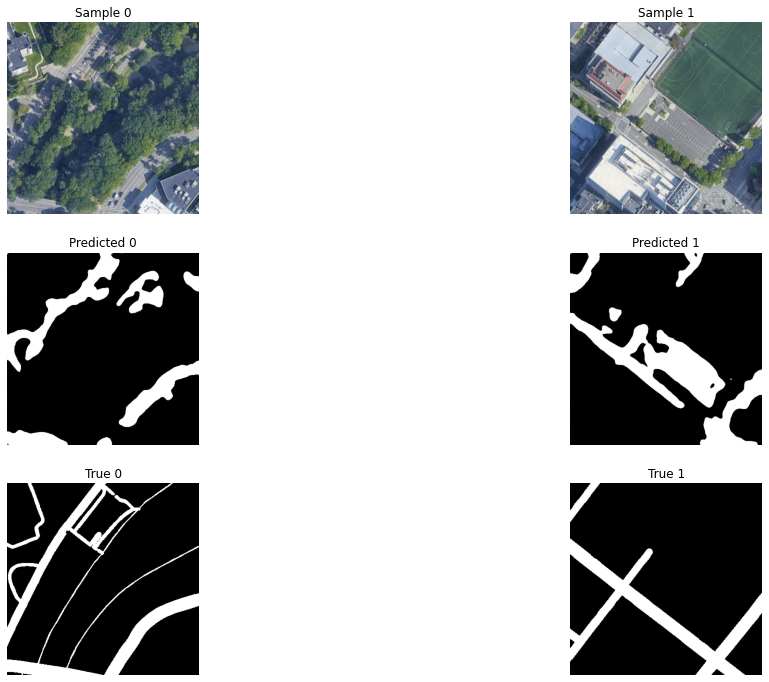

Epoch 12/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.35643928366548877
  	- val_loss = 0.49437495072682697
  	- acc = 0.8607512905317194
  	- val_acc = 0.8427525361378988
  	- patch_acc = 0.8408267042216133
  	- val_patch_acc = 0.8111979166666666
 


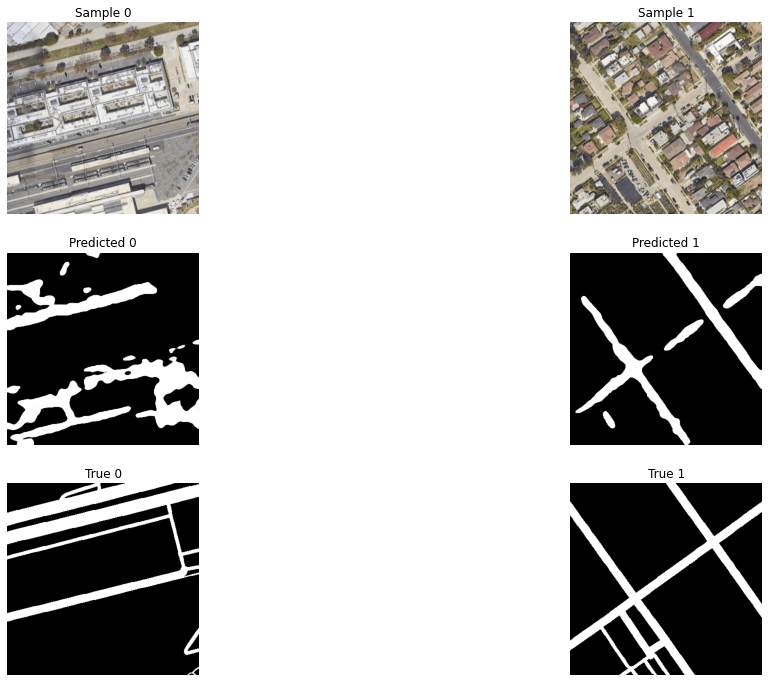

Epoch 13/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.36379431275760427
  	- val_loss = 0.44736262162526447
  	- acc = 0.857725111877217
  	- val_acc = 0.8538654446601868
  	- patch_acc = 0.8382097745642942
  	- val_patch_acc = 0.8307291865348816
 


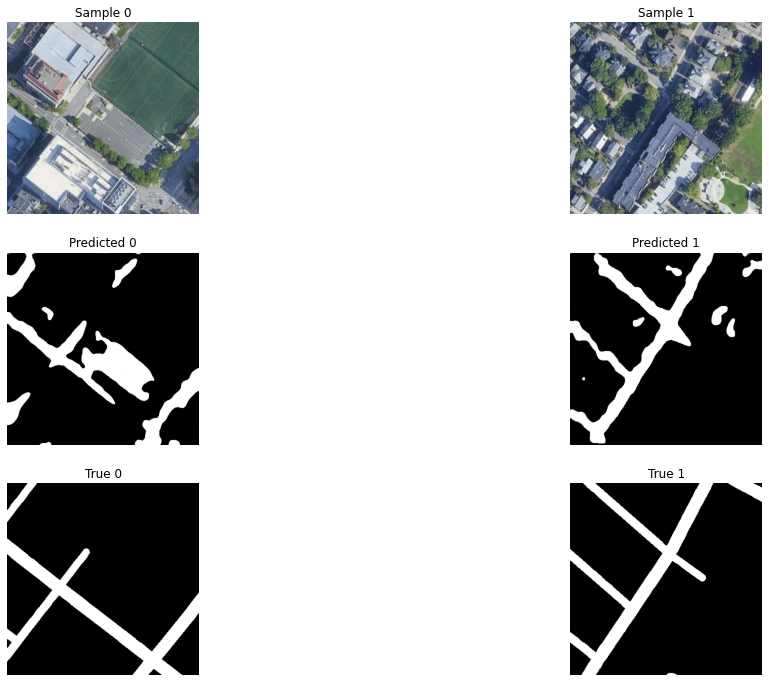

Epoch 14/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.3446134784642388
  	- val_loss = 0.4500565727551778
  	- acc = 0.8671011381289538
  	- val_acc = 0.8323200345039368
  	- patch_acc = 0.8462903447010938
  	- val_patch_acc = 0.8152488470077515
 


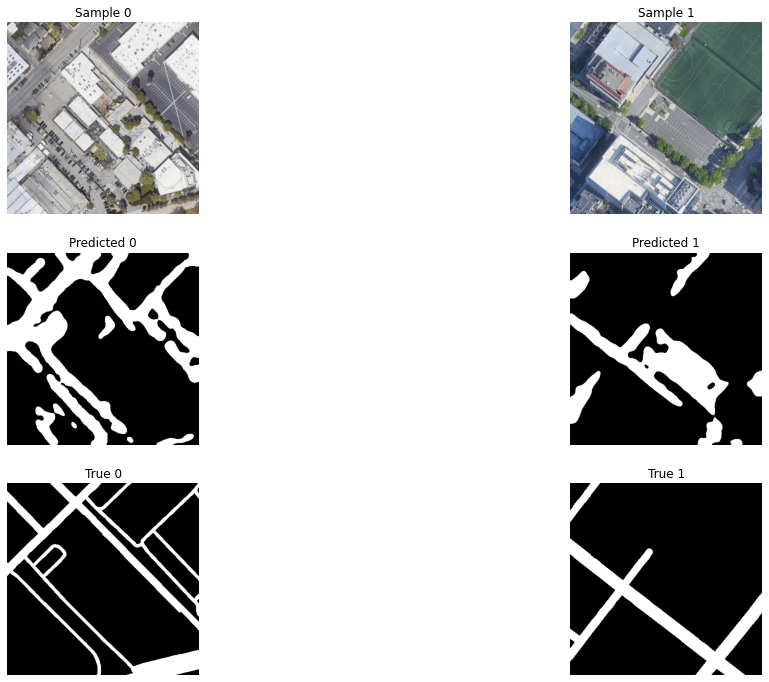

Epoch 15/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.3449208280619453
  	- val_loss = 0.45348846912384033
  	- acc = 0.8663203961708966
  	- val_acc = 0.8416380882263184
  	- patch_acc = 0.8468647932305056
  	- val_patch_acc = 0.8143808046976725
 


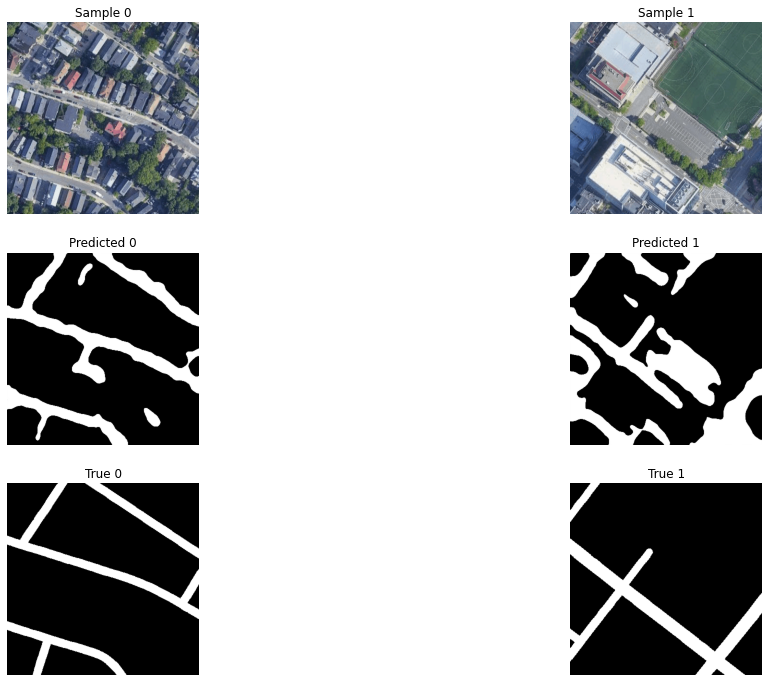

Epoch 16/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.3547556891160853
  	- val_loss = 0.4734445611635844
  	- acc = 0.8604599237442017
  	- val_acc = 0.849962592124939
  	- patch_acc = 0.8399969427024617
  	- val_patch_acc = 0.821035901705424
 


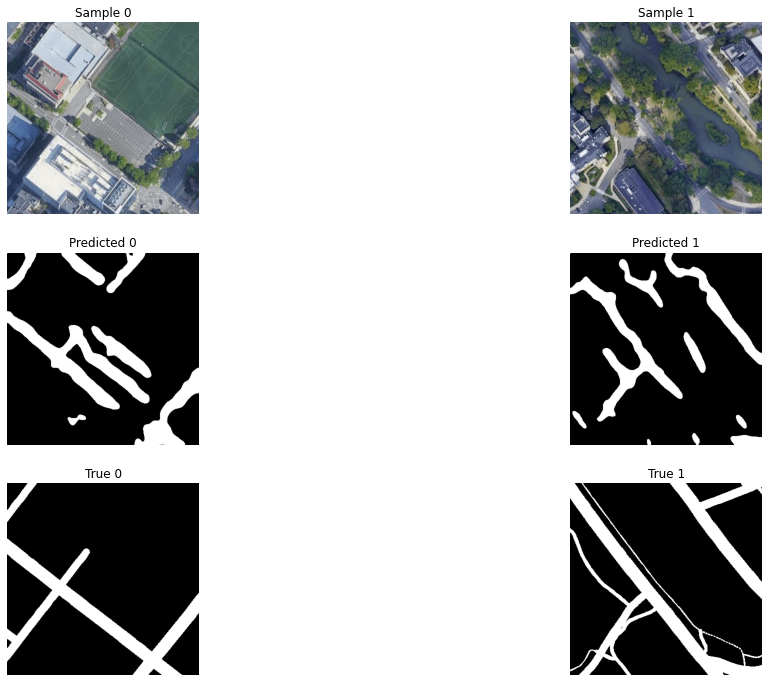

Epoch 17/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.32156042491688447
  	- val_loss = 0.36862526337305707
  	- acc = 0.8770792414160336
  	- val_acc = 0.8569567600886027
  	- patch_acc = 0.8598856259794796
  	- val_patch_acc = 0.8414351940155029
 


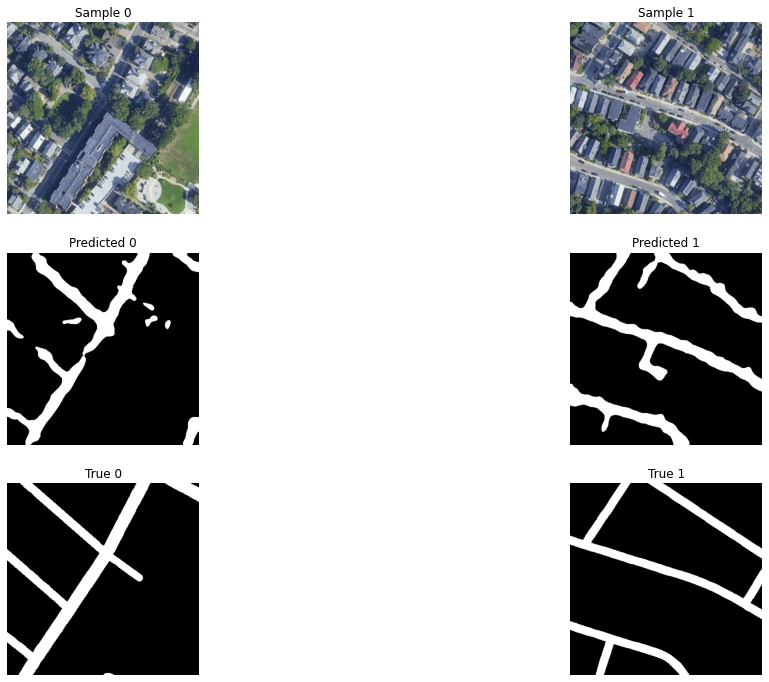

Epoch 18/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.31859926616444306
  	- val_loss = 0.45092934370040894
  	- acc = 0.878142725018894
  	- val_acc = 0.8530505100886027
  	- patch_acc = 0.8610983543536243
  	- val_patch_acc = 0.8255208532015482
 


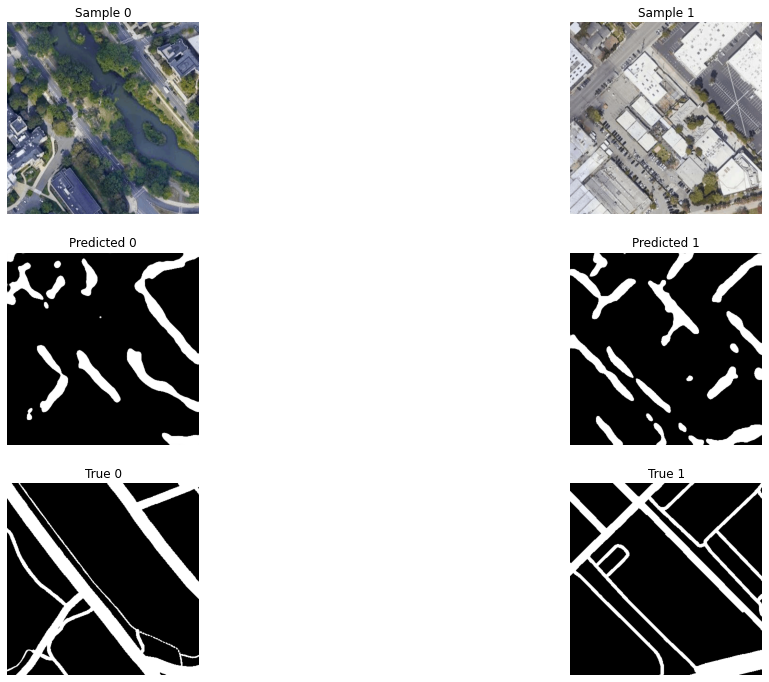

Epoch 19/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.32539084904334126
  	- val_loss = 0.3959283431371053
  	- acc = 0.8766445149393642
  	- val_acc = 0.8593224485715231
  	- patch_acc = 0.8576644290896023
  	- val_patch_acc = 0.8420138955116272
 


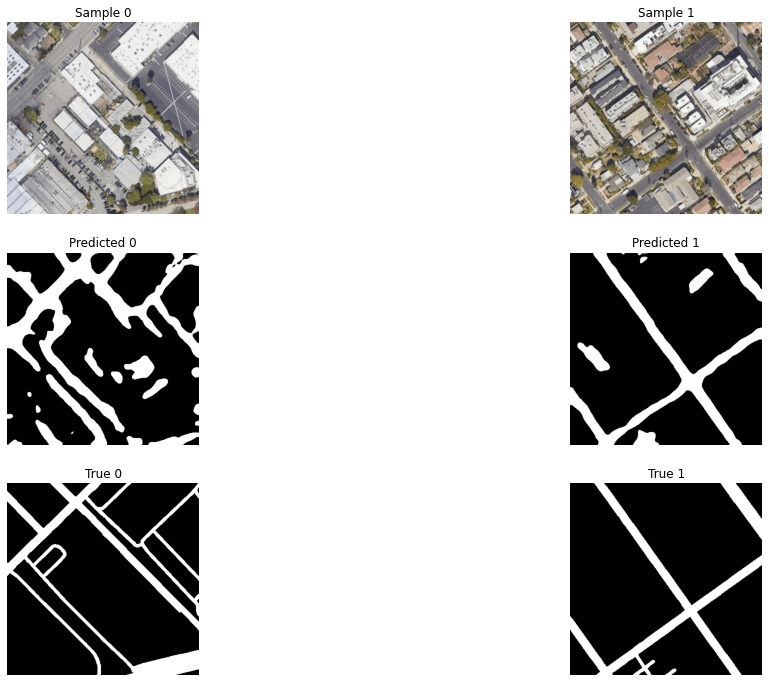

Epoch 20/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.3216475423644571
  	- val_loss = 0.43466277917226154
  	- acc = 0.8784969115958494
  	- val_acc = 0.8814996878306071
  	- patch_acc = 0.8614174881402183
  	- val_patch_acc = 0.8590856393178304
 


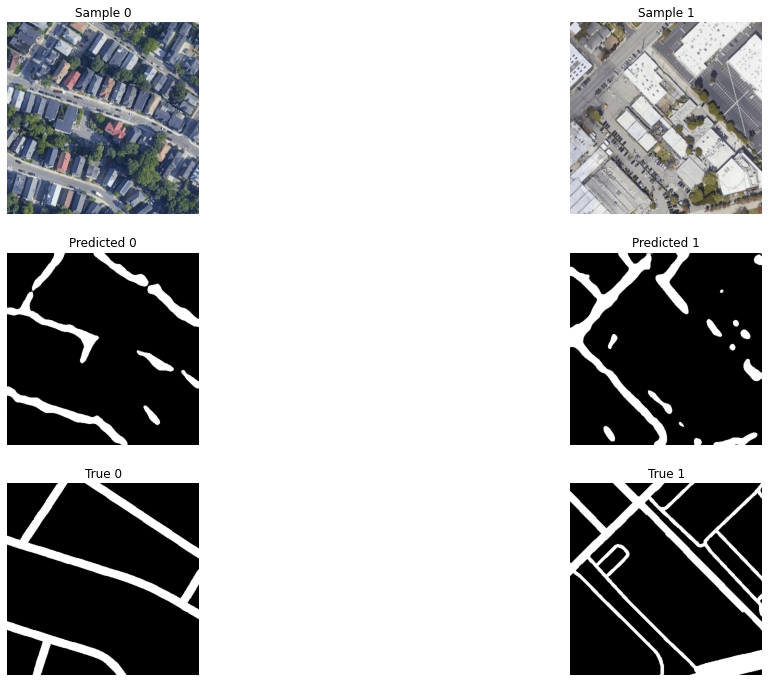

Epoch 21/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.3057001198039335
  	- val_loss = 0.3718521197636922
  	- acc = 0.8885920521091012
  	- val_acc = 0.8728959957758585
  	- patch_acc = 0.8715277875170988
  	- val_patch_acc = 0.858506957689921
 


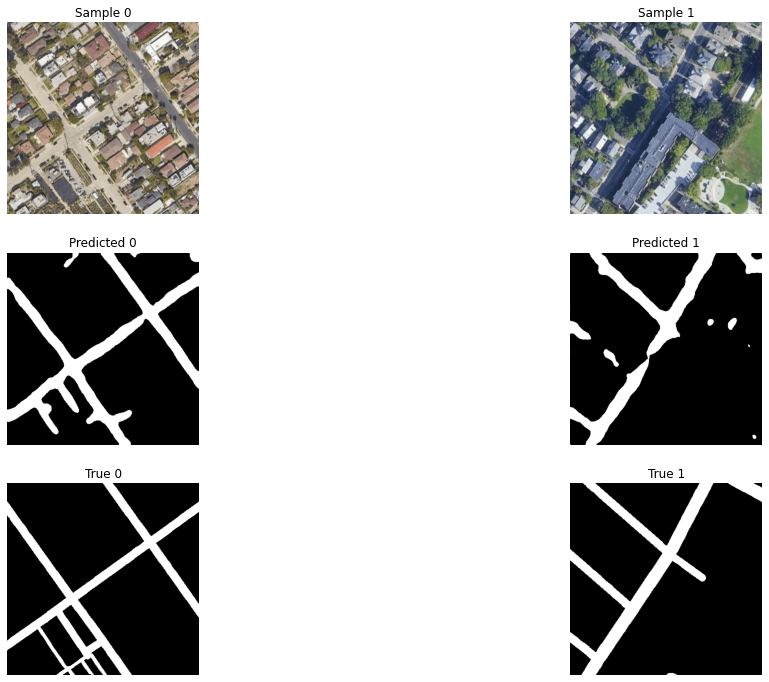

Epoch 22/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.2884918188347536
  	- val_loss = 0.4170113801956177
  	- acc = 0.8912241879631492
  	- val_acc = 0.8269918958346049
  	- patch_acc = 0.8758042332004098
  	- val_patch_acc = 0.8081597288449606
 


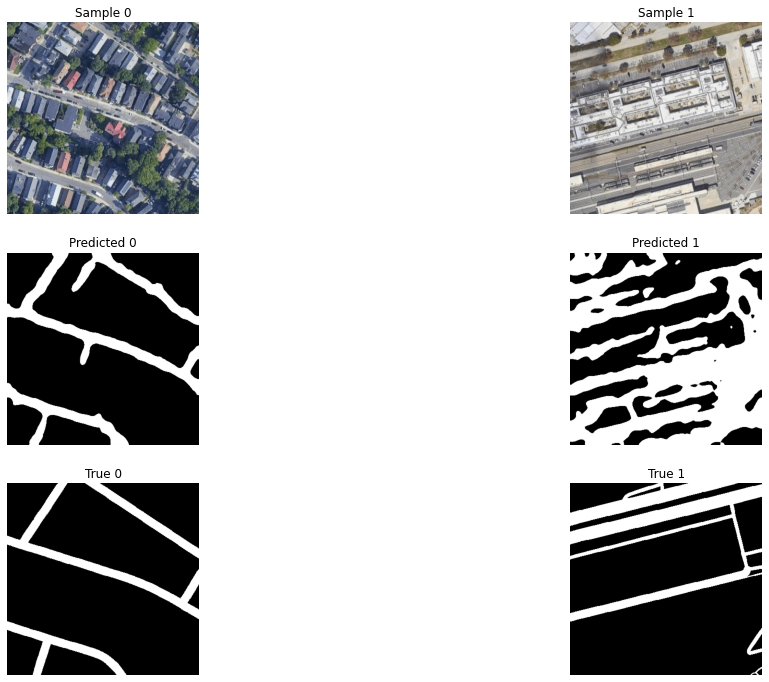

Epoch 23/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.28696419035687165
  	- val_loss = 0.4120502869288127
  	- acc = 0.8933552836670595
  	- val_acc = 0.8958694934844971
  	- patch_acc = 0.8775914153631996
  	- val_patch_acc = 0.8778935273488363
 


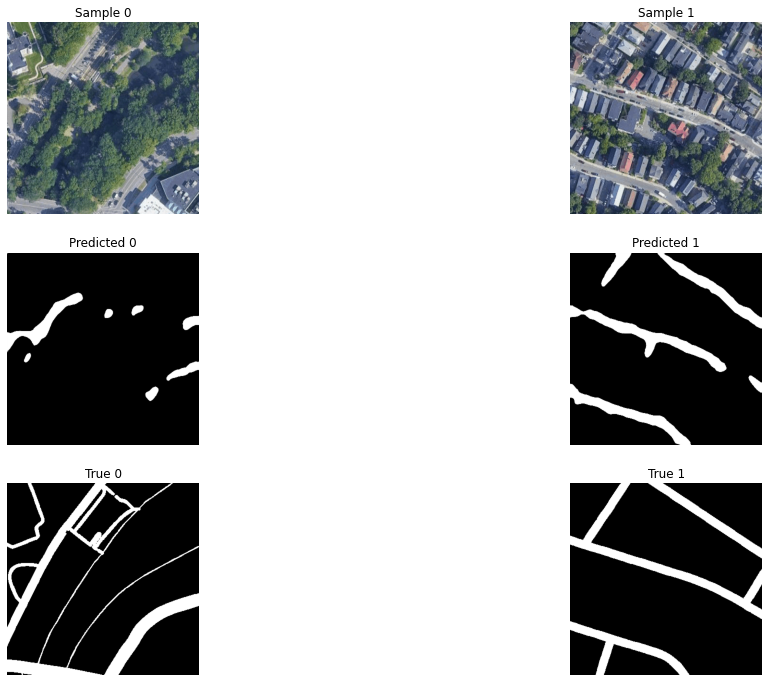

Epoch 24/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.2955060986911549
  	- val_loss = 0.38542165358861286
  	- acc = 0.890874585684608
  	- val_acc = 0.867353101571401
  	- patch_acc = 0.8743489700205186
  	- val_patch_acc = 0.8583622773488363
 


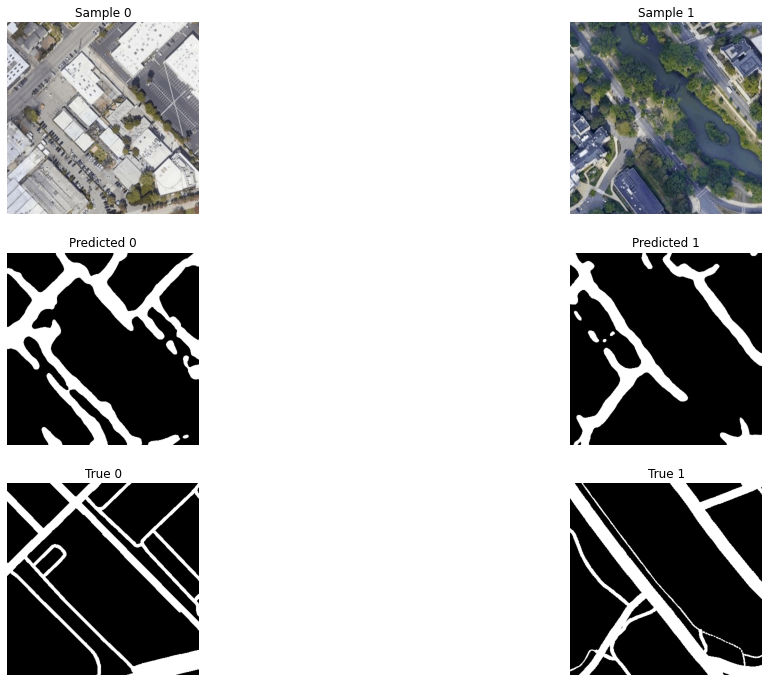

Epoch 25/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.30521907701211815
  	- val_loss = 0.4206829071044922
  	- acc = 0.8854538202285767
  	- val_acc = 0.8789435625076294
  	- patch_acc = 0.8683236399117638
  	- val_patch_acc = 0.8576388756434122
 


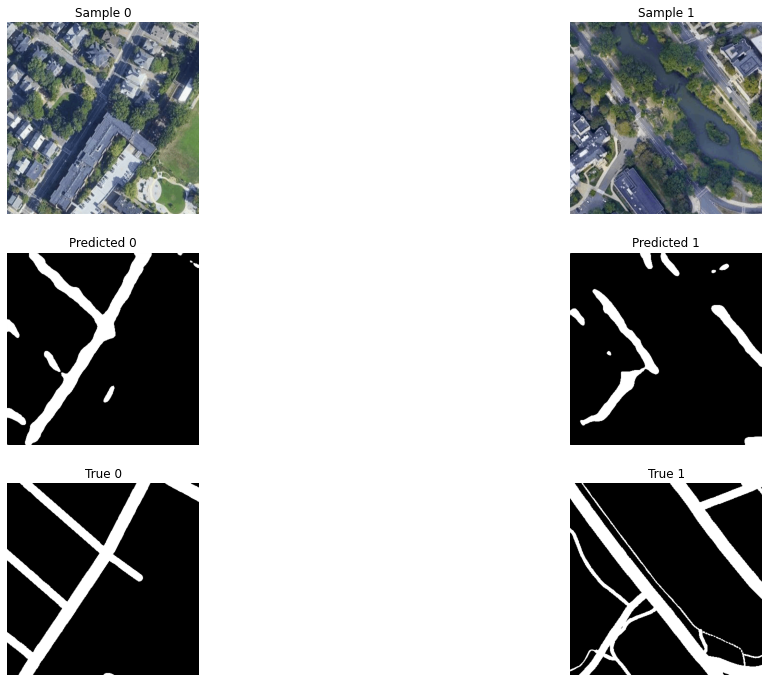

Epoch 26/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.27646395038155946
  	- val_loss = 0.41956833998362225
  	- acc = 0.8987143109826481
  	- val_acc = 0.8720443248748779
  	- patch_acc = 0.8834635475102592
  	- val_patch_acc = 0.8441840410232544
 


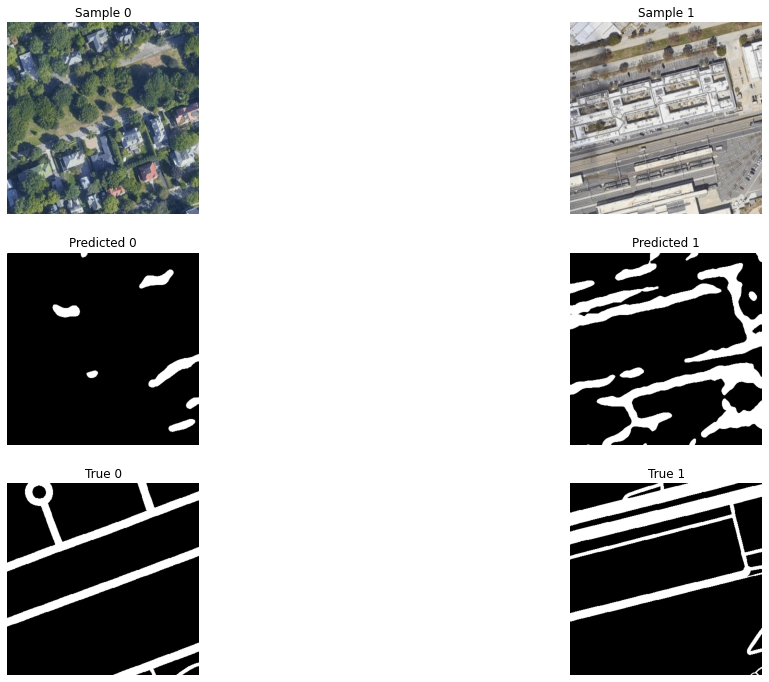

Epoch 27/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.2815600861521328
  	- val_loss = 0.4218095342318217
  	- acc = 0.8930303086252773
  	- val_acc = 0.8733119169871012
  	- patch_acc = 0.877629700829001
  	- val_patch_acc = 0.8480902910232544
 


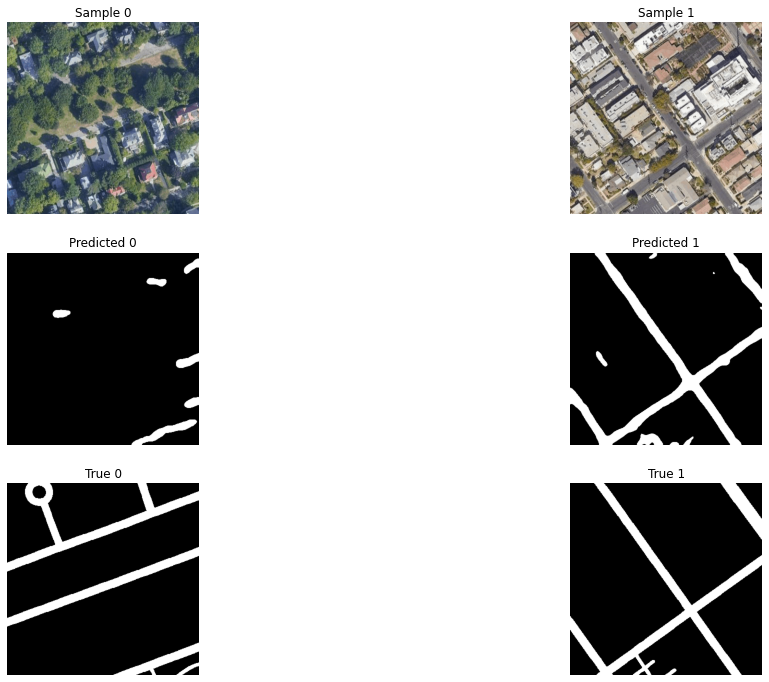

Epoch 28/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.26842135716887083
  	- val_loss = 0.3322022159894307
  	- acc = 0.9016612487680772
  	- val_acc = 0.8861287434895834
  	- patch_acc = 0.8878421222462374
  	- val_patch_acc = 0.8716724514961243
 


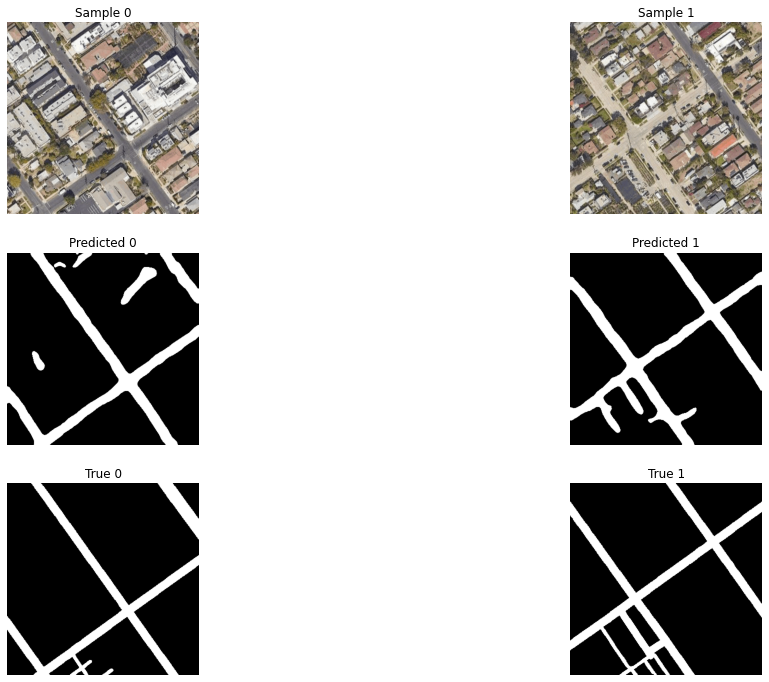

Epoch 29/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.26256029746111703
  	- val_loss = 0.3903584082921346
  	- acc = 0.903319025740904
  	- val_acc = 0.8706461588541666
  	- patch_acc = 0.8900633243953481
  	- val_patch_acc = 0.8469328681627909
 


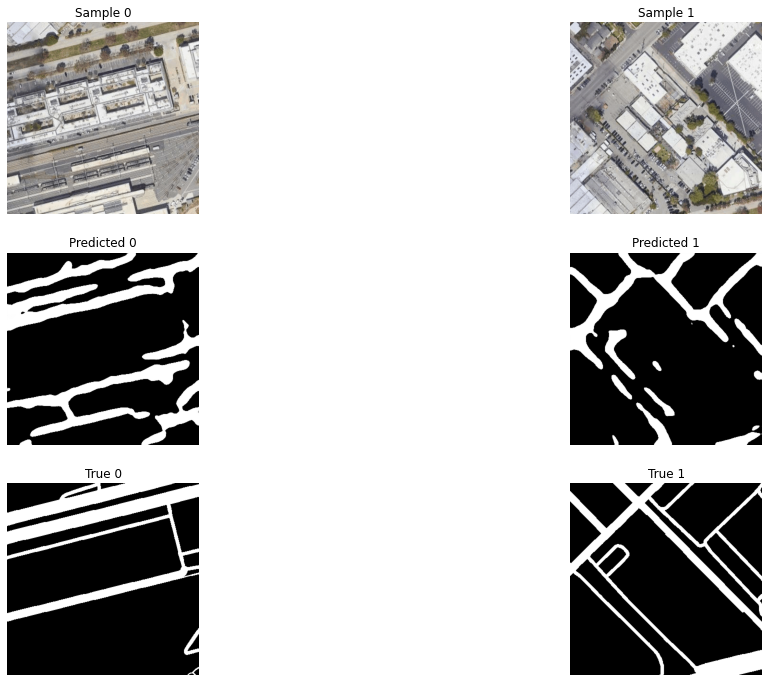

Epoch 30/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.2599523803767036
  	- val_loss = 0.45219282309214276
  	- acc = 0.9037992761415594
  	- val_acc = 0.863826056321462
  	- patch_acc = 0.890420757672366
  	- val_patch_acc = 0.8328993121782938
 


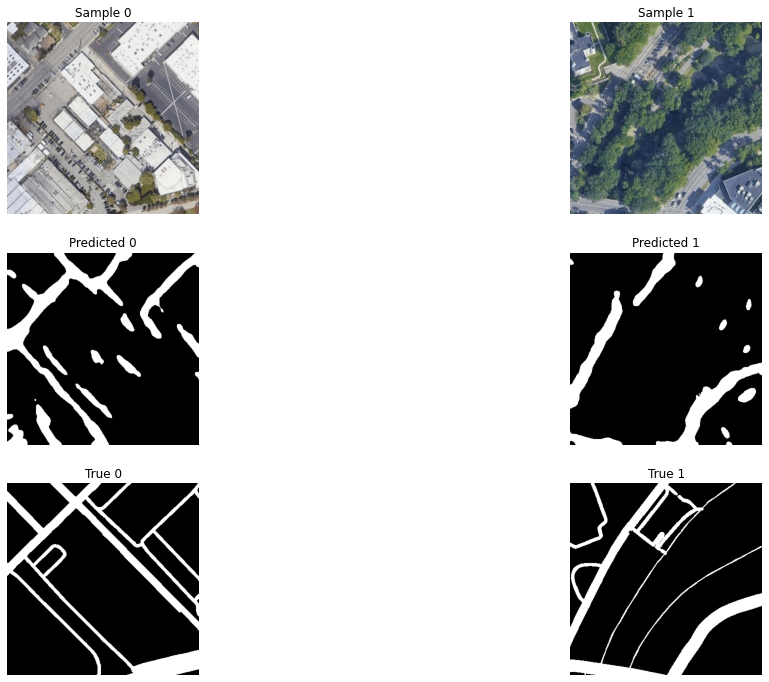

Epoch 31/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.28242852582651023
  	- val_loss = 0.3726537823677063
  	- acc = 0.8959572543116177
  	- val_acc = 0.8853138089179993
  	- patch_acc = 0.8814976583508884
  	- val_patch_acc = 0.8693576256434122
 


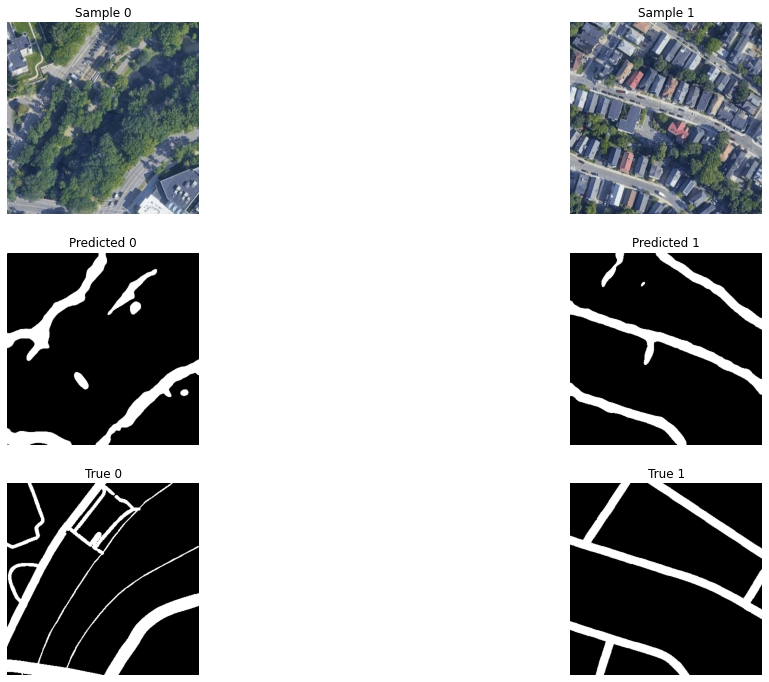

Epoch 32/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.2785500778871424
  	- val_loss = 0.52838001648585
  	- acc = 0.8968671490164364
  	- val_acc = 0.8748784859975179
  	- patch_acc = 0.8827614398563609
  	- val_patch_acc = 0.8407118121782938
 


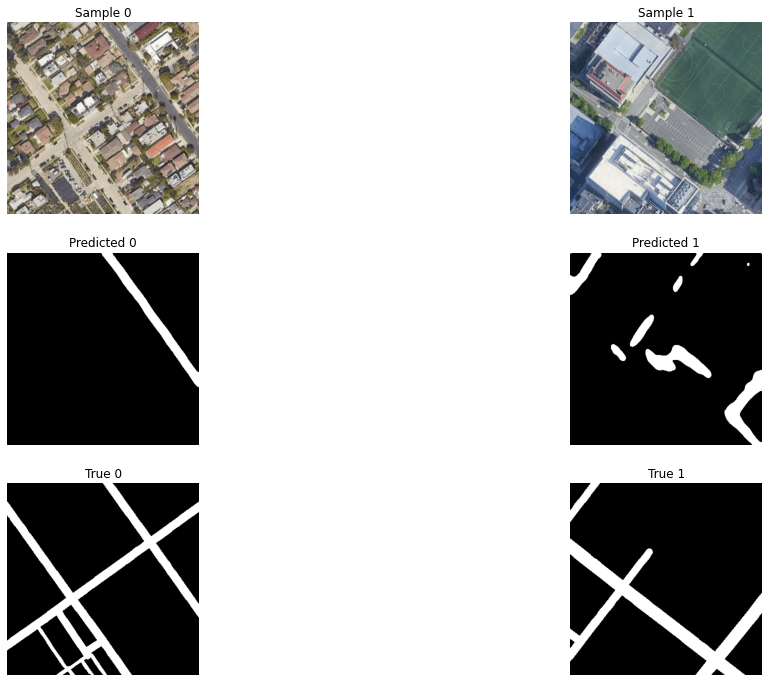

Epoch 33/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.2766033814233892
  	- val_loss = 0.37399383385976154
  	- acc = 0.8979891731458551
  	- val_acc = 0.86001984278361
  	- patch_acc = 0.8815742468132692
  	- val_patch_acc = 0.8383969863255819
 


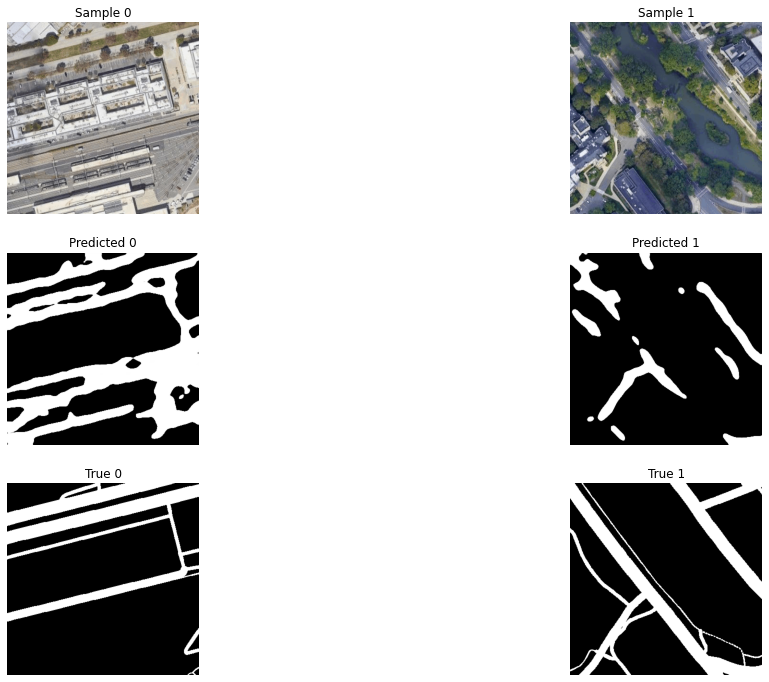

Epoch 34/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.2607009708881378
  	- val_loss = 0.43371764818827313
  	- acc = 0.9048824520672069
  	- val_acc = 0.8752017617225647
  	- patch_acc = 0.8898718392147738
  	- val_patch_acc = 0.8525752226511637
 


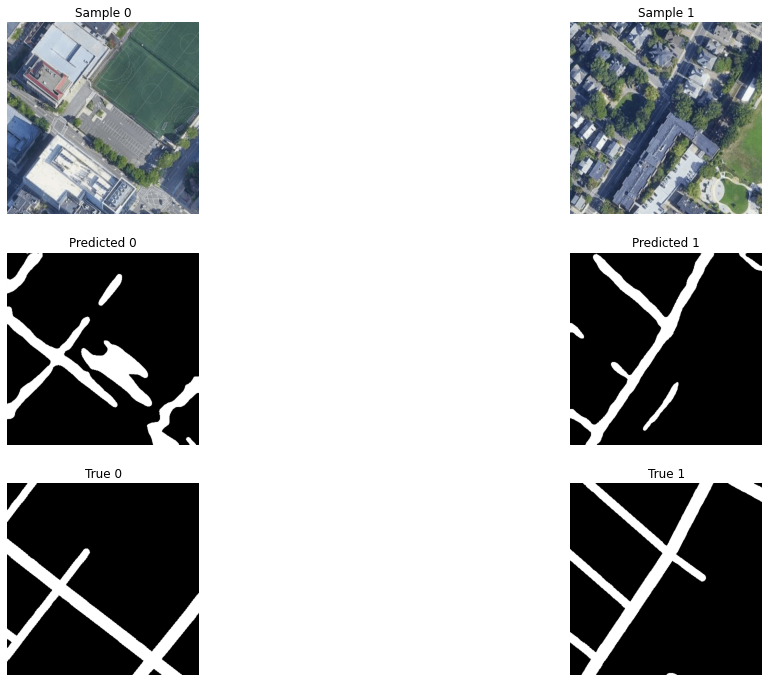

Epoch 35/35:   0%|          | 0/34 [00:00<?, ?it/s]

	- loss = 0.2508303207509658
  	- val_loss = 0.3367673357327779
  	- acc = 0.908134961829466
  	- val_acc = 0.8988675673802694
  	- patch_acc = 0.8941993485478794
  	- val_patch_acc = 0.8833912014961243
 


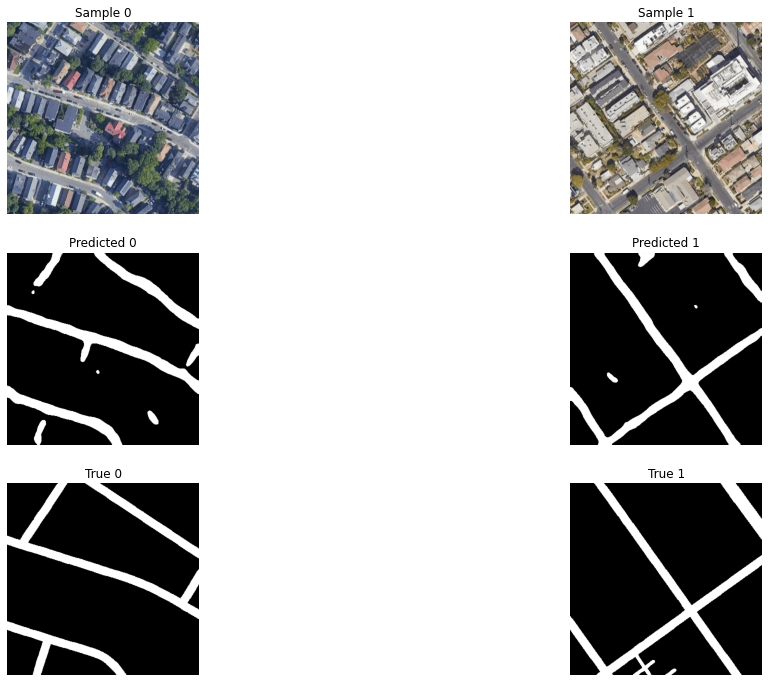

Finished Training


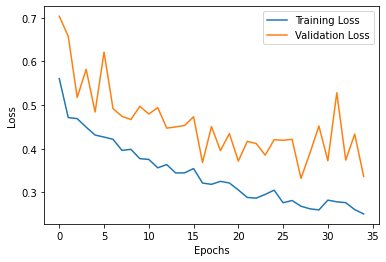

In [152]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
# reshape the image to simplify the handling of skip connections and maxpooling
train_dataset = ImageDataset(train_path, device, use_patches=False, resize_to=(384, 384))
val_dataset = ImageDataset(val_path, device, use_patches=False, resize_to=(384, 384))
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=4, shuffle=True)
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=4, shuffle=True)
model = UNet().to(device)
loss_fn = soft_dice_loss
metric_fns = {'acc': accuracy_fn, 'patch_acc': patch_accuracy_fn}
optimizer = torch.optim.Adam(model.parameters())
n_epochs = 35
train(train_dataloader, val_dataloader, model, loss_fn, metric_fns, optimizer, n_epochs)


Predict network on test set:

In [149]:
# predict on test set
test_filenames = (glob(test_path + '/*.png'))
test_images = load_all_from_path(test_path)
batch_size = test_images.shape[0]
size = test_images.shape[1:3]
# we also need to resize the test images. This might not be the best ideas depending on their spatial resolution.
test_images = np.stack([cv2.resize(img, dsize=(384, 384)) for img in test_images], 0)
test_images = test_images[:, :, :, :3]
test_images = np_to_tensor(np.moveaxis(test_images, -1, 1), device)
test_pred = [model(t).detach().cpu().numpy() for t in test_images.unsqueeze(1)]
test_pred = np.concatenate(test_pred, 0)
test_pred= np.moveaxis(test_pred, 1, -1)  # CHW to HWC
test_pred = np.stack([cv2.resize(img, dsize=size) for img in test_pred], 0)  # resize to original shape
# now compute labels
test_pred = test_pred.reshape((-1, size[0] // PATCH_SIZE, PATCH_SIZE, size[0] // PATCH_SIZE, PATCH_SIZE))
test_pred = np.moveaxis(test_pred, 2, 3)
test_pred = np.round(np.mean(test_pred, (-1, -2)) > CUTOFF)
create_submission(test_pred, test_filenames, submission_filename='baseline.csv')

# Test postprocessing

## Methods for visualization

In [73]:
def show_first_n(imgs, masks, n=5):
    # visualizes the first n elements of a series of images and segmentation masks
    imgs_to_draw = min(n, len(imgs))
    fig, axs = plt.subplots(2, imgs_to_draw, figsize=(18.5, 6))
    for i in range(imgs_to_draw):
        axs[0, i].imshow(imgs[i])
        axs[1, i].imshow(masks[i])
        axs[0, i].set_title(f'Image {i}')
        axs[1, i].set_title(f'Mask {i}')
        axs[0, i].set_axis_off()
        axs[1, i].set_axis_off()
    plt.show()

def image_to_patches(images, masks=None):
    # takes in a 4D np.array containing images and (optionally) a 4D np.array containing the segmentation masks
    # returns a 4D np.array with an ordered sequence of patches extracted from the image and (optionally) a np.array containing labels
    n_images = images.shape[0]  # number of images
    h, w = images.shape[1:3]  # shape of images
    assert (h % PATCH_SIZE) + (w % PATCH_SIZE) == 0  # make sure images can be patched exactly

    images = images[:,:,:,:3]
    
    h_patches = h // PATCH_SIZE
    w_patches = w // PATCH_SIZE
    
    patches = images.reshape((n_images, h_patches, PATCH_SIZE, w_patches, PATCH_SIZE, -1))
    patches = np.moveaxis(patches, 2, 3)
    patches = patches.reshape(-1, PATCH_SIZE, PATCH_SIZE, 3)
    if masks is None:
        return patches

    masks = masks.reshape((n_images, h_patches, PATCH_SIZE, w_patches, PATCH_SIZE, -1))
    masks = np.moveaxis(masks, 2, 3)
    labels = np.mean(masks, (-1, -2, -3)) > CUTOFF  # compute labels
    labels = labels.reshape(-1).astype(np.float32)
    return patches, labels

def show_patched_image(patches, labels, h_patches=25, w_patches=25):
  # reorders a set of patches in their original 2D shape and visualizes them
  fig, axs = plt.subplots(h_patches, w_patches, figsize=(18.5, 18.5))
  for i, (p, l) in enumerate(zip(patches, labels)):
      # the np.maximum operation paints patches labeled as road red
      axs[i // w_patches, i % w_patches].imshow(np.maximum(p, np.array([l.item(), 0., 0.])))
      axs[i // w_patches, i % w_patches].set_axis_off()
  plt.show()

## Morphological Postprocessing

In [142]:
def morphological_postprocessing(imgs):
    result = []
    for img in imgs:
        kernel = np.ones((3,3), np.uint8)
        img = img * 255
        _, img = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)
        img = img / 255
        img = cv2.erode(img, kernel, iterations=5)
        img = cv2.dilate(img, kernel, iterations=5)
        result.append(img)
    result = np.stack(result)
    return result

In [145]:
# predict on test set
test_filenames = (glob(test_path + '/*.png'))
test_images = load_all_from_path(test_path)
batch_size = test_images.shape[0]
size = test_images.shape[1:3]
# we also need to resize the test images. This might not be the best ideas depending on their spatial resolution.
test_images = np.stack([cv2.resize(img, dsize=(384, 384)) for img in test_images], 0)
test_images = test_images[:, :, :, :3]
test_images = np_to_tensor(np.moveaxis(test_images, -1, 1), device)
test_pred = [model(t).detach().cpu().numpy() for t in test_images.unsqueeze(1)]
test_pred = np.concatenate(test_pred, 0)
test_pred= np.moveaxis(test_pred, 1, -1)  # CHW to HWC
test_pred = np.stack([cv2.resize(img, dsize=size) for img in test_pred], 0)  # resize to original shape
test_pred = morphological_postprocessing(test_pred)
# now compute labels
test_pred = test_pred.reshape((-1, size[0] // PATCH_SIZE, PATCH_SIZE, size[0] // PATCH_SIZE, PATCH_SIZE))
test_pred = np.moveaxis(test_pred, 2, 3)
test_pred = np.round(np.mean(test_pred, (-1, -2)) > CUTOFF)
create_submission(test_pred, test_filenames, submission_filename='mprphological_postprocessing.csv')

## Majority Voting

In [146]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

def prediction(imagesOrg, flip, rot, morphological):
  
  size = imagesOrg.shape[1:3]
  images = np.stack([cv2.resize(img, dsize=(384, 384)) for img in imagesOrg], 0)
  images = images[:, :, :, :3]

  images_aug = []
  for img in images:
    img_aug = img
    for i in range(rot):
      img_aug = np.rot90(img_aug)
    if flip:
      img_aug = np.flip(img_aug, axis=1)
    images_aug.append(img_aug)
  images_aug = np.array(images_aug)
  test_images = np_to_tensor(np.moveaxis(images_aug, -1, 1), device)
  test_pred = [model(t).detach().cpu().numpy() for t in test_images.unsqueeze(1)]
  test_pred = np.concatenate(test_pred, 0)
  test_pred = np.moveaxis(test_pred, 1, -1)  # CHW to HWC
  test_pred = np.stack([cv2.resize(img, dsize=size) for img in test_pred], 0)  # resize to original shape
  if morphological:
    test_pred = morphological_postprocessing(test_pred)
  # now compute labels
  test_pred = test_pred.reshape((-1, size[0] // PATCH_SIZE, PATCH_SIZE, size[0] // PATCH_SIZE, PATCH_SIZE))
  test_pred = np.moveaxis(test_pred, 2, 3)
  test_pred = np.round(np.mean(test_pred, (-1, -2)) > CUTOFF)
  test_pred_back = []
  for tp in test_pred:
    tp_back = tp
    if flip:
      tp_back = np.flip(tp_back, axis=1)
    for i in range(4 - rot):
      tp_back = np.rot90(tp_back)
    test_pred_back.append(tp_back)

  test_pred_back = np.array(test_pred_back)

  # draw images for debugging
  #img_patches = image_to_patches(imagesOrg[0:2])
  #show_patched_image(img_patches[:25*25], test_pred_back[0].reshape(-1))
  

  return test_pred_back


def majority_voting(path):
  test_filenames = (glob(path + '/*.png'))
  test_images = load_all_from_path(test_path)

  test_preds = prediction(test_images, 0, 0, False)
  for i, j in [(0, 1), (0, 2), (0, 3), (1, 0), (1, 1), (1, 2), (1, 3)]:
    test_preds += prediction(test_images, i, j, False)
  test_preds = test_preds / 8 >= 0.5
  return test_preds

In [110]:
result = majority_voting("test/images")

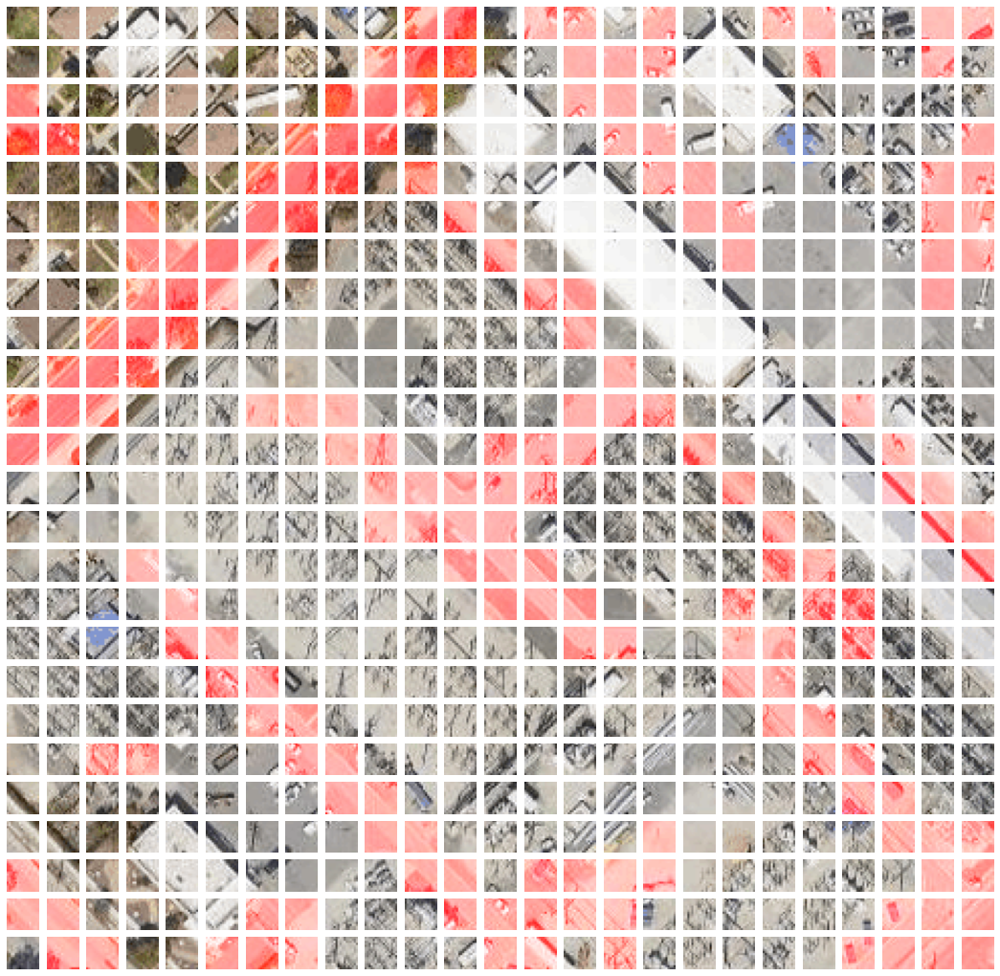

0 1:


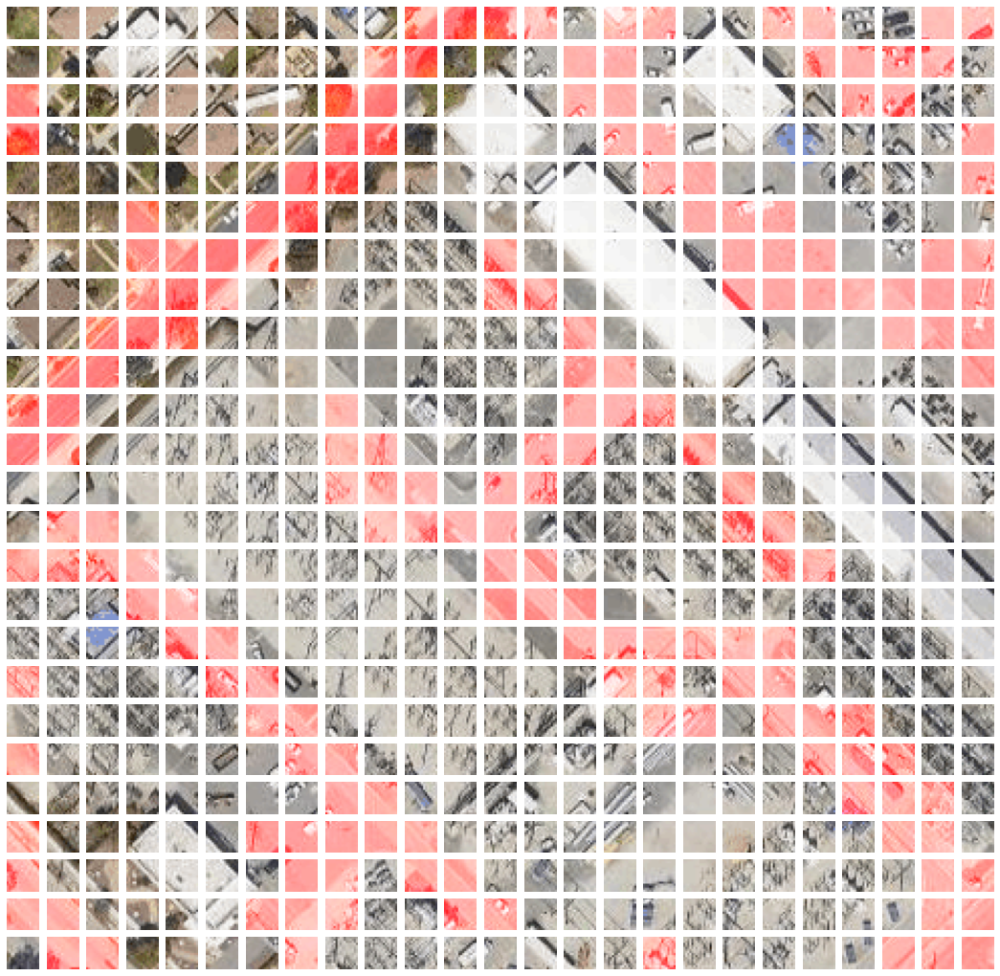

0 2:


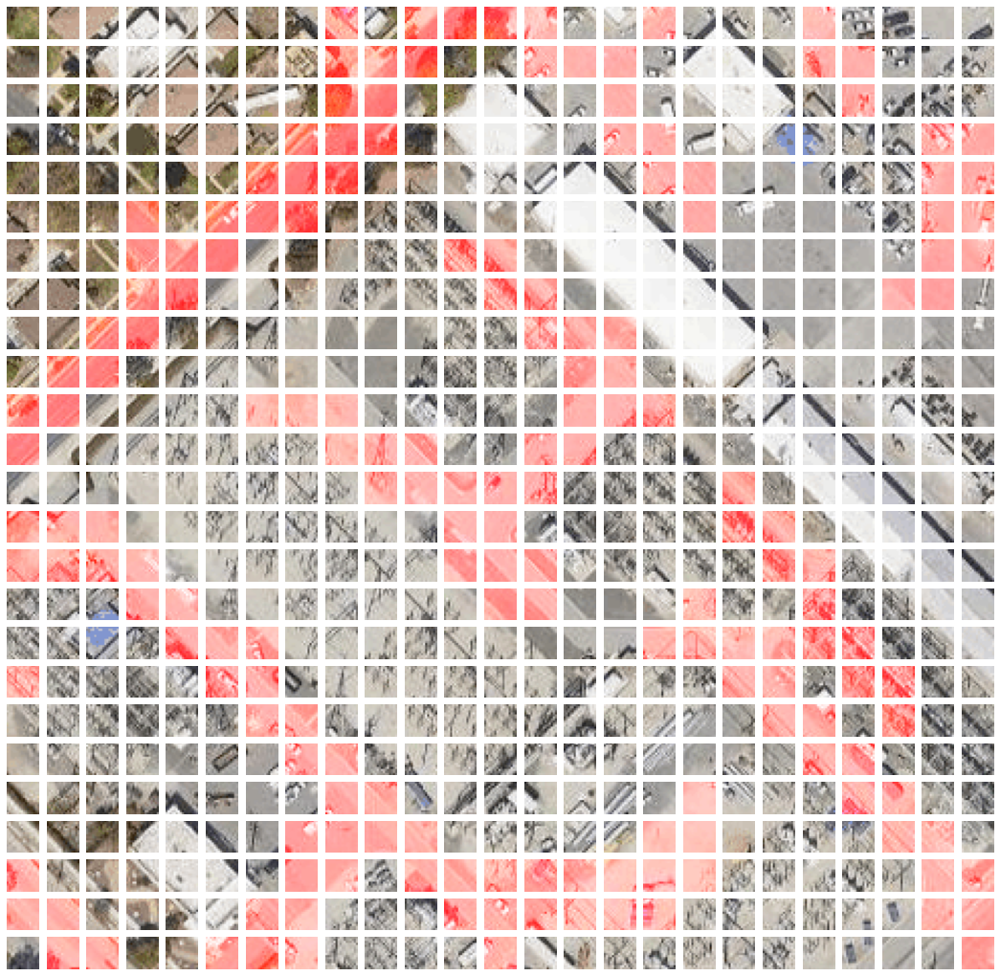

0 3:


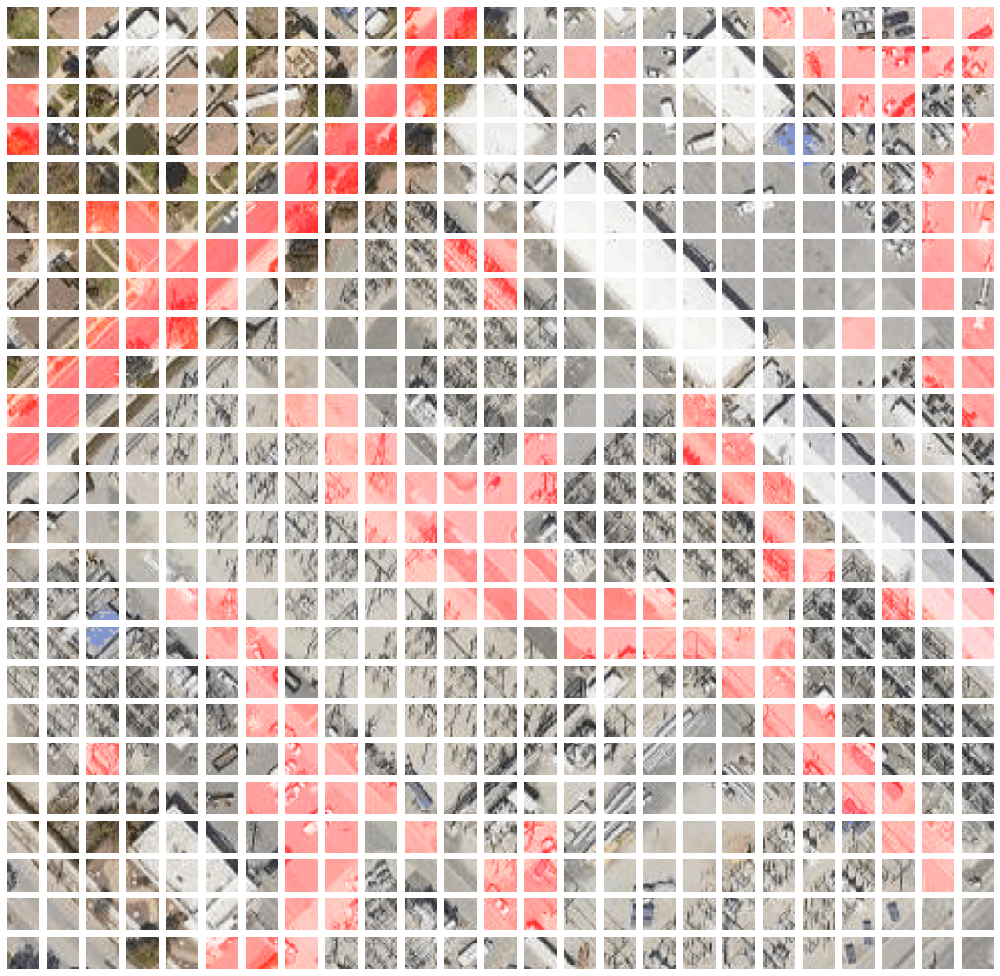

1 0:


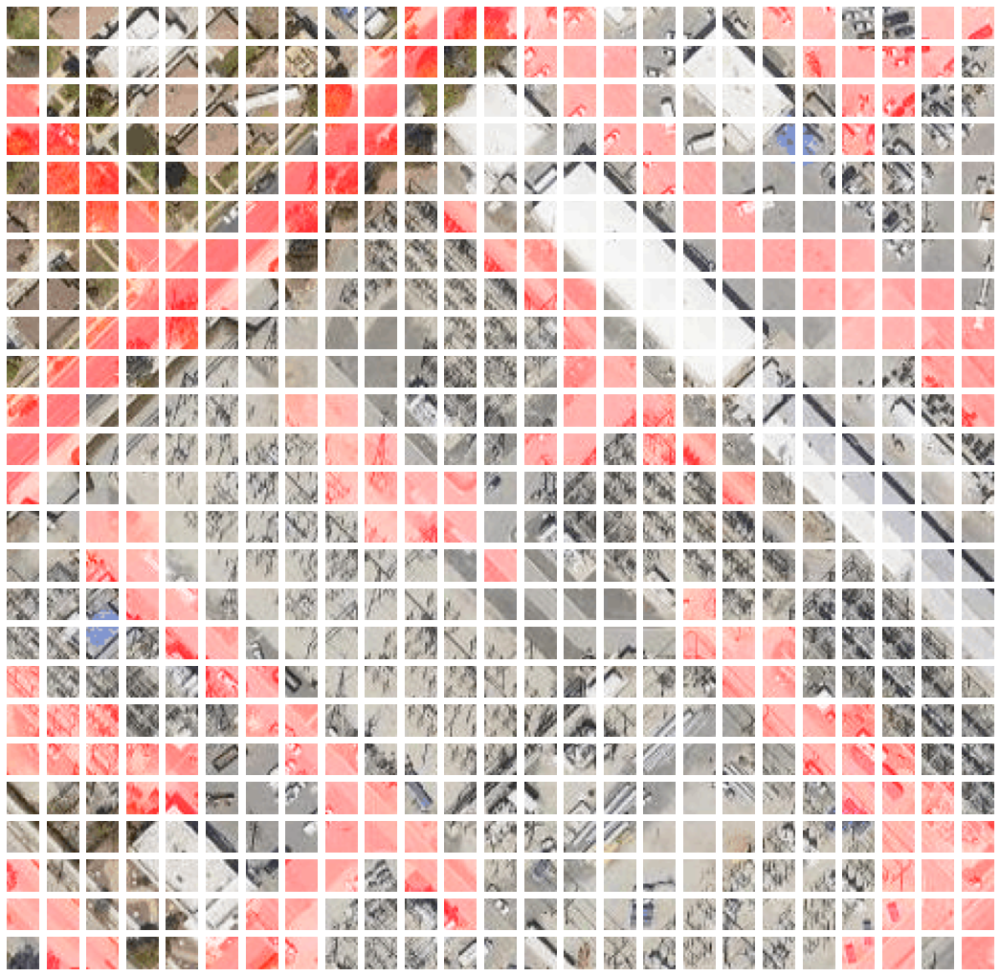

1 1:


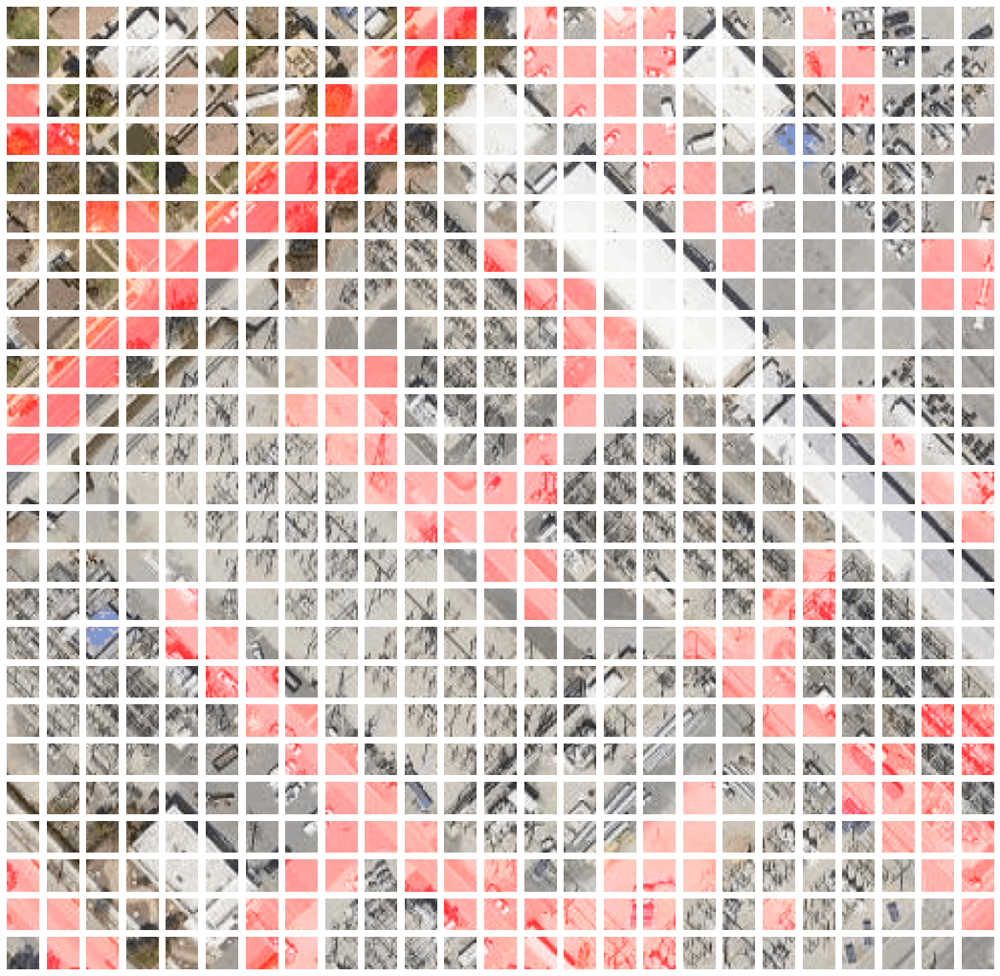

1 2:


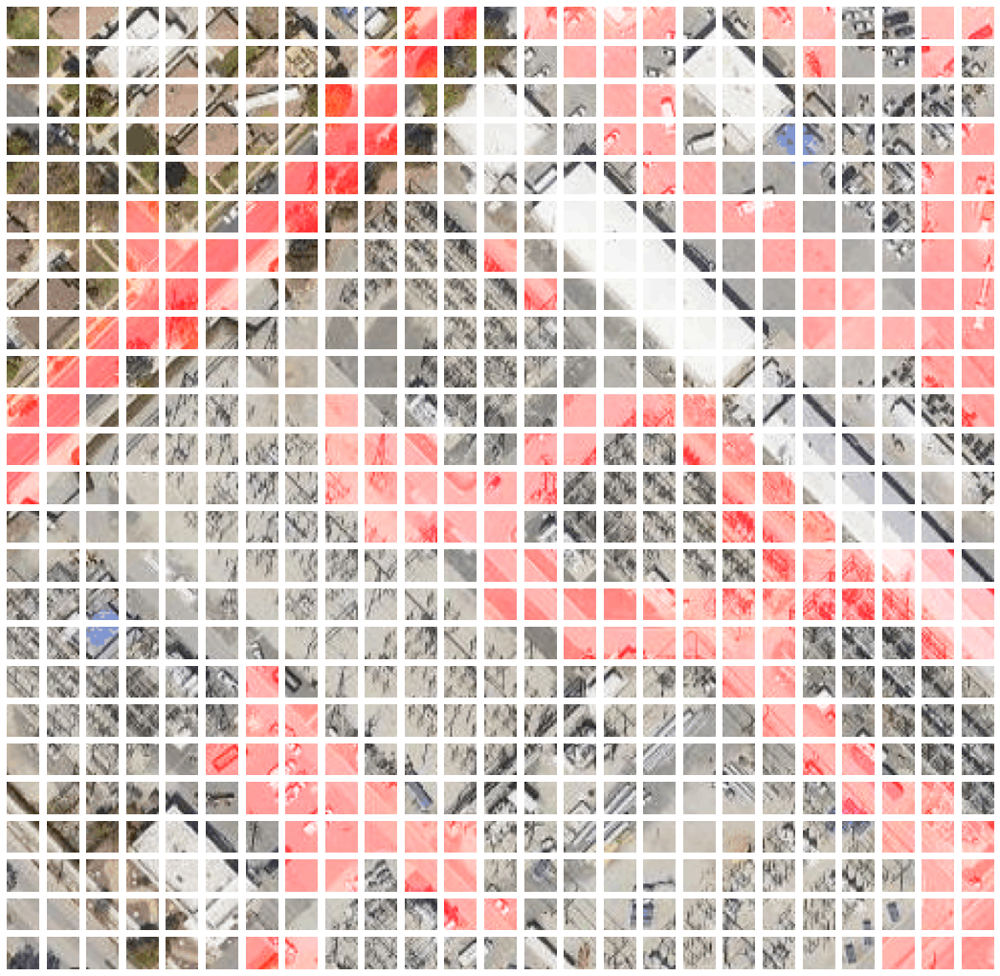

1 3:


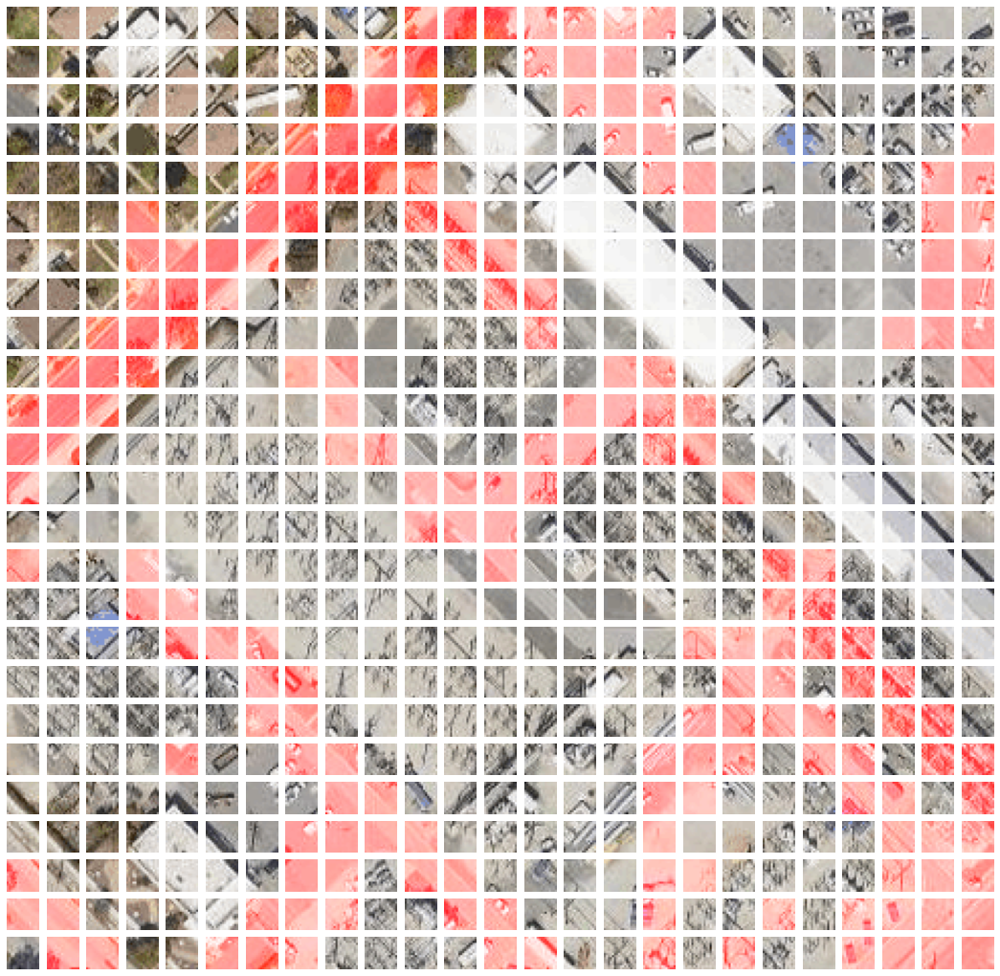

(144, 25, 25)


In [104]:
result = majority_voting("test/images")
print(result.shape)

In [111]:
test_filenames = (glob(test_path + '/*.png'))
create_submission(result, test_filenames, submission_filename='unet_filtered_road_data.csv')

# Config for postprocessing

In [147]:
def postprocessing_prediction(path, augmented, morphological):
  test_filenames = (glob(path + '/*.png'))
  test_images = load_all_from_path(test_path)
  
  test_preds = prediction(test_images, 0, 0, morphological)
  if augmented:
    for i, j in [(0, 1), (0, 2), (0, 3), (1, 0), (1, 1), (1, 2), (1, 3)]:
      test_preds += prediction(test_images, i, j, morphological)
    test_preds = test_preds / 8 >= 0.5
  return test_preds

In [148]:
result = postprocessing_prediction("test/images", True, True)
create_submission(result, test_filenames, submission_filename='postprocessed.csv')